# ReneWind

Renewable energy sources play an increasingly important role in the global energy mix, as the effort to reduce the environmental impact of energy production increases.

Out of all the renewable energy alternatives, wind energy is one of the most developed technologies worldwide. The U.S Department of Energy has put together a guide to achieving operational efficiency using predictive maintenance practices.

Predictive maintenance uses sensor information and analysis methods to measure and predict degradation and future component capability. The idea behind predictive maintenance is that failure patterns are predictable and if component failure can be predicted accurately and the component is replaced before it fails, the costs of operation and maintenance will be much lower.

The sensors fitted across different machines involved in the process of energy generation collect data related to various environmental factors (temperature, humidity, wind speed, etc.) and additional features related to various parts of the wind turbine (gearbox, tower, blades, break, etc.). 



## Objective
“ReneWind” is a company working on improving the machinery/processes involved in the production of wind energy using machine learning and has collected data of generator failure of wind turbines using sensors. They have shared a ciphered version of the data, as the data collected through sensors is confidential (the type of data collected varies with companies). Data has 40 predictors, 20000 observations in the training set and 5000 in the test set.

The objective is to build various classification models, tune them, and find the best one that will help identify failures so that the generators could be repaired before failing/breaking to reduce the overall maintenance cost. 
The nature of predictions made by the classification model will translate as follows:

- True positives (TP) are failures correctly predicted by the model. These will result in repairing costs.
- False negatives (FN) are real failures where there is no detection by the model. These will result in replacement costs.
- False positives (FP) are detections where there is no failure. These will result in inspection costs.

It is given that the cost of repairing a generator is much less than the cost of replacing it, and the cost of inspection is less than the cost of repair.

“1” in the target variables should be considered as “failure” and “0” represents “No failure”.

## Data Description
- The data provided is a transformed version of original data which was collected using sensors.
- Train.csv - To be used for training and tuning of models. 
- Test.csv - To be used only for testing the performance of the final best model.
- Both the datasets consist of 40 predictor variables and 1 target variable

## Importing libraries

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


from sklearn.model_selection import train_test_split
from sklearn.impute import KNNImputer, SimpleImputer
from sklearn.preprocessing import StandardScaler, MinMaxScaler



import warnings
warnings.filterwarnings("ignore")

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier,RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier, StackingClassifier
from xgboost import XGBClassifier
from sklearn import metrics
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score

from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

## Loading Data

In [2]:
train=pd.read_csv('Train.csv')
test=pd.read_csv('Test.csv')
df=train.copy()
df.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-4.464606,-4.679129,3.101546,0.506130,-0.221083,-2.032511,-2.910870,0.050714,-1.522351,3.761892,...,3.059700,-1.690440,2.846296,2.235198,6.667486,0.443809,-2.369169,2.950578,-3.480324,0
1,3.365912,3.653381,0.909671,-1.367528,0.332016,2.358938,0.732600,-4.332135,0.565695,-0.101080,...,-1.795474,3.032780,-2.467514,1.894599,-2.297780,-1.731048,5.908837,-0.386345,0.616242,0
2,-3.831843,-5.824444,0.634031,-2.418815,-1.773827,1.016824,-2.098941,-3.173204,-2.081860,5.392621,...,-0.257101,0.803550,4.086219,2.292138,5.360850,0.351993,2.940021,3.839160,-4.309402,0
3,1.618098,1.888342,7.046143,-1.147285,0.083080,-1.529780,0.207309,-2.493629,0.344926,2.118578,...,-3.584425,-2.577474,1.363769,0.622714,5.550100,-1.526796,0.138853,3.101430,-1.277378,0
4,-0.111440,3.872488,-3.758361,-2.982897,3.792714,0.544960,0.205433,4.848994,-1.854920,-6.220023,...,8.265896,6.629213,-10.068689,1.222987,-3.229763,1.686909,-2.163896,-3.644622,6.510338,0


# Let's start by checking some basic things...

In [3]:
df.duplicated().sum()
#no duplicate rows...

0

In [4]:
df.describe(include='all').T
#there may be missing data in V1 and V2.

,count,mean,std,min,25%,50%,75%,max
V1,19982.0,-0.271996,3.441625,-11.876451,-2.737146,-0.747917,1.840112,15.493002
V2,19982.0,0.440430,3.150784,-12.319951,-1.640674,0.471536,2.543967,13.089269
V3,20000.0,2.484699,3.388963,-10.708139,0.206860,2.255786,4.566165,17.090919
V4,20000.0,-0.083152,3.431595,-15.082052,-2.347660,-0.135241,2.130615,13.236381
V5,20000.0,-0.053752,2.104801,-8.603361,-1.535607,-0.101952,1.340480,8.133797
V6,20000.0,-0.995443,2.040970,-10.227147,-2.347238,-1.000515,0.380330,6.975847
V7,20000.0,-0.879325,1.761626,-7.949681,-2.030926,-0.917179,0.223695,8.006091
V8,20000.0,-0.548195,3.295756,-15.657561,-2.642665,-0.389085,1.722965,11.679495
V9,20000.0,-0.016808,2.160568,-8.596313,-1.494973,-0.067597,1.409203,8.137580
V10,20000.0,-0.012998,2.193201,-9.853957,-1.411212,0.100973,1.477045,8.108472


In [5]:
df.isnull().sum()
#we'll deal with missing values as part of the later pipeline.

V1        18
V2        18
V3         0
V4         0
V5         0
V6         0
V7         0
V8         0
V9         0
V10        0
V11        0
V12        0
V13        0
V14        0
V15        0
V16        0
V17        0
V18        0
V19        0
V20        0
V21        0
V22        0
V23        0
V24        0
V25        0
V26        0
V27        0
V28        0
V29        0
V30        0
V31        0
V32        0
V33        0
V34        0
V35        0
V36        0
V37        0
V38        0
V39        0
V40        0
Target     0
dtype: int64

In [6]:
df['Target'].value_counts()

0    18890
1     1110
Name: Target, dtype: int64

In [7]:
(df['Target'].value_counts()[1])/(df['Target'].value_counts()[0])

0.058761249338274216

In [8]:
(test['Target'].value_counts()[1])/(test['Target'].value_counts()[0])

0.05977108944467995

In [9]:
test.describe().T
#just checking test's Target variable for missing values.
#V1 and V2 are also missing values, so there is no need to impute anything but V1 and V2 on the test dataset.

,count,mean,std,min,25%,50%,75%,max
V1,4995.0,-0.277622,3.466280,-12.381696,-2.743691,-0.764767,1.831313,13.504352
V2,4994.0,0.397928,3.139562,-10.716179,-1.649211,0.427369,2.444486,14.079073
V3,5000.0,2.551787,3.326607,-9.237940,0.314931,2.260428,4.587000,15.314503
V4,5000.0,-0.048943,3.413937,-14.682446,-2.292694,-0.145753,2.166468,12.140157
V5,5000.0,-0.080120,2.110870,-7.711569,-1.615238,-0.131890,1.341197,7.672835
V6,5000.0,-1.042138,2.005444,-8.924196,-2.368853,-1.048571,0.307555,5.067685
V7,5000.0,-0.907922,1.769017,-8.124230,-2.054259,-0.939695,0.212228,7.616182
V8,5000.0,-0.574592,3.331911,-12.252731,-2.642088,-0.357943,1.712896,10.414722
V9,5000.0,0.030121,2.174139,-6.785495,-1.455712,-0.079891,1.449548,8.850720
V10,5000.0,0.018524,2.145437,-8.170956,-1.353320,0.166292,1.511248,6.598728


# Highly imbalanced data. Around a 6|94 class split.

# EDA


## Univariate Analysis

### Plotting histograms and boxplots for all the variables

In [10]:
def histobox(data, feature, figsize=(15, 5), kde=False, bins=100):
    
#bins= number of sections of a histogram 

    HBP, (box,hist) = plt.subplots(
        nrows=2,
        sharex=True, #sharex and sharey just means the x and y axis won't show up for both, only one (usually bottom or left)
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize
    )
    sns.boxplot(
        data=data, x=feature, ax=box, showmeans=True, color="orange"
    )
    sns.histplot(
        data=data, x=feature, kde=kde, ax=hist, bins=bins, palette="mako" #i like mako
    )
    hist.axvline(
        data[feature].mean(), color="green", linestyle="--"
    )
    hist.axvline(
        data[feature].median(), color="black", linestyle="-"
    )

### Plotting all the features at one go

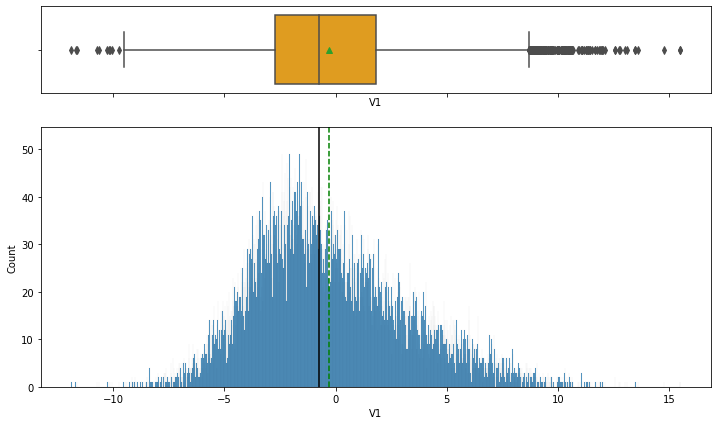

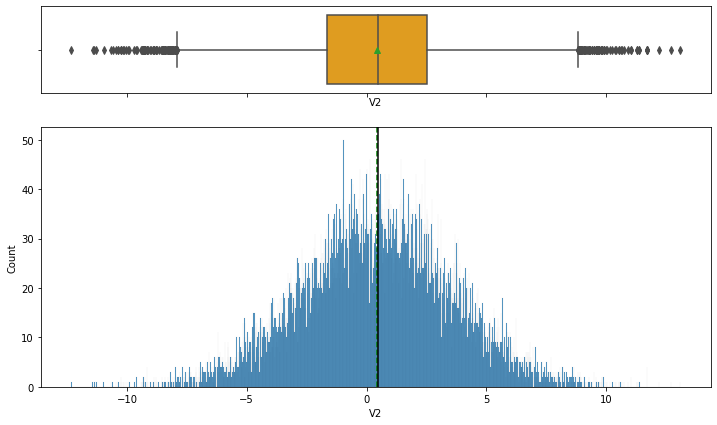

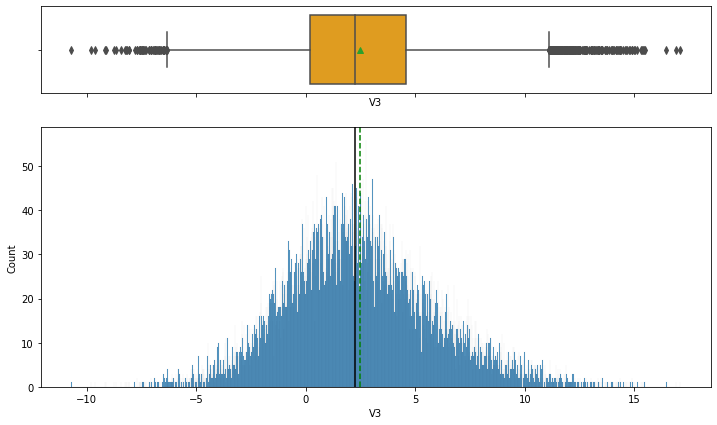

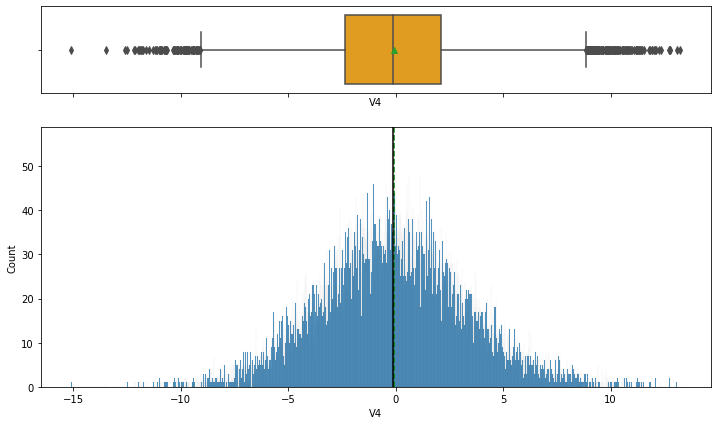

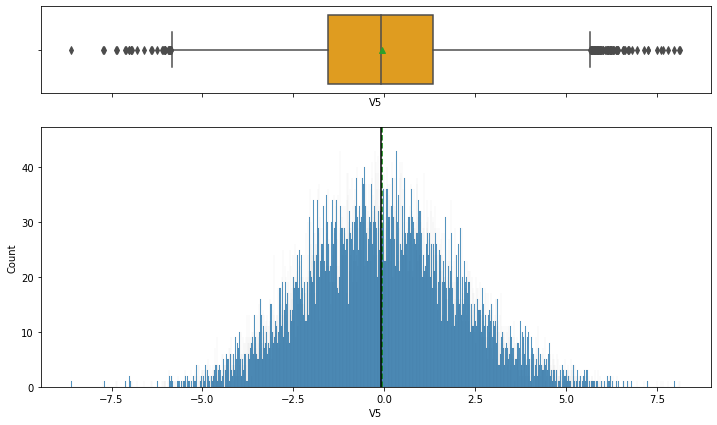

...

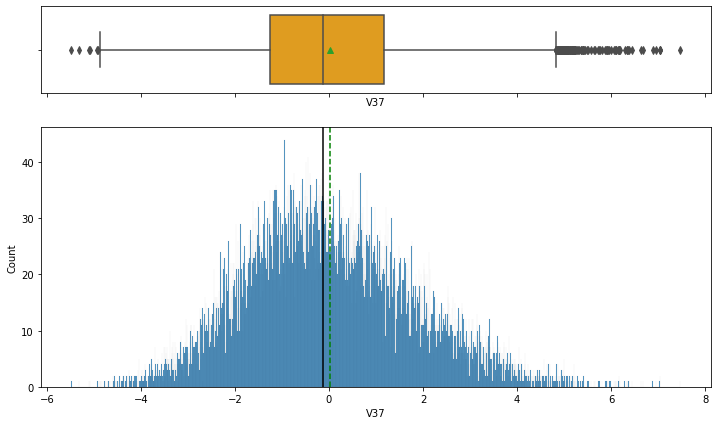

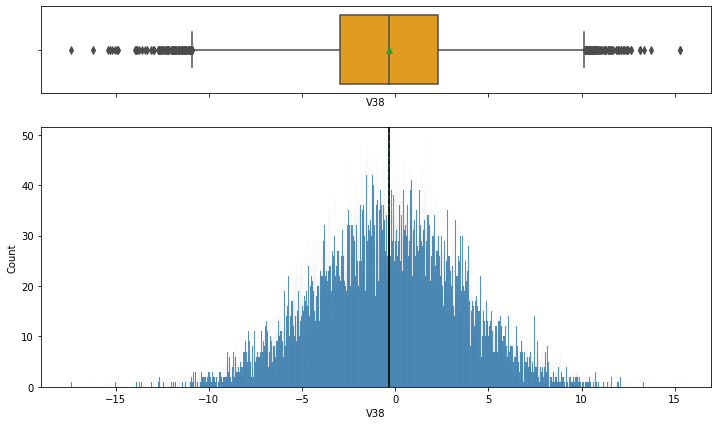

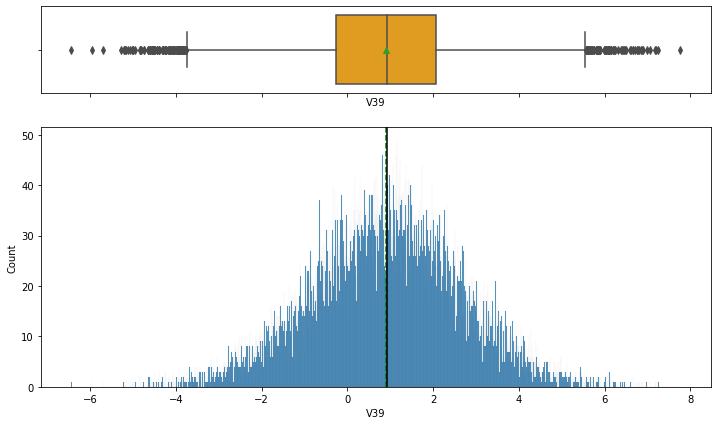

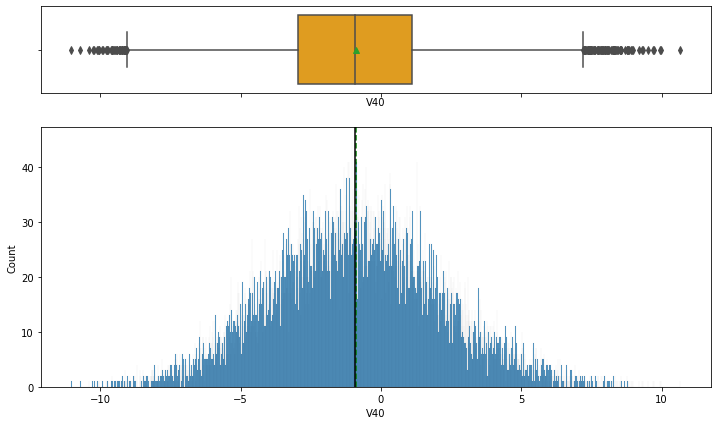

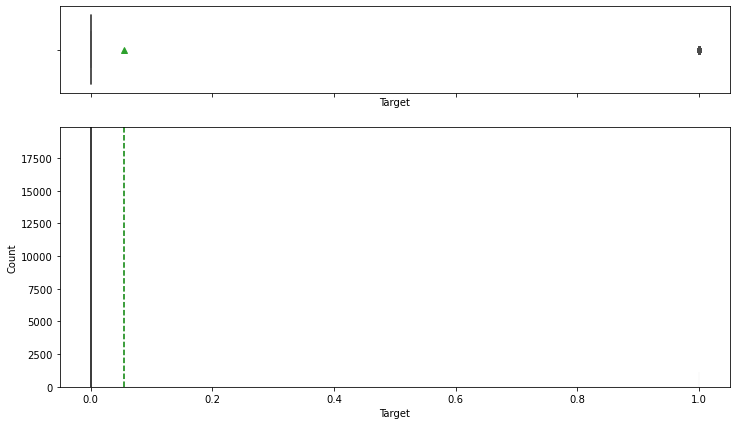

In [11]:
for feature in df.columns:
    histobox(df, feature, figsize=(12, 7), kde=False, bins=2000) ## Please change the dataframe name as you define while reading the data

### All of the columns (besides target, obviously) are fairly normal already.

# Bivariate Analysis
### Heatmap for the target variable:

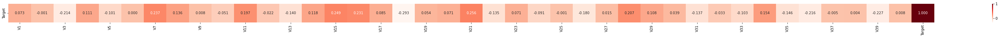

In [12]:
sns.heatmap(pd.DataFrame(df.corr()['Target']).T,annot=True,fmt='.3f',cmap='Reds')
plt.gcf().set_size_inches(60,1)

### The strongest correlations between the dependent and target variables are V18 (-0.293), V39 (-0.227), V15 (0.249), and V21 (0.256).

In [13]:
sns.pairplot(df);

In [14]:
for columns in df.columns:
    print(f"{columns} sum of rows > 0.9 corr: {(df.corr()[columns]>0.9).sum()}")

V1 sum of rows > 0.9 corr: 1
V2 sum of rows > 0.9 corr: 1
V3 sum of rows > 0.9 corr: 1
V4 sum of rows > 0.9 corr: 1
V5 sum of rows > 0.9 corr: 1
V6 sum of rows > 0.9 corr: 1
V7 sum of rows > 0.9 corr: 1
V8 sum of rows > 0.9 corr: 1
V9 sum of rows > 0.9 corr: 1
V10 sum of rows > 0.9 corr: 1
V11 sum of rows > 0.9 corr: 1
V12 sum of rows > 0.9 corr: 1
V13 sum of rows > 0.9 corr: 1
V14 sum of rows > 0.9 corr: 1
V15 sum of rows > 0.9 corr: 1
V16 sum of rows > 0.9 corr: 1
V17 sum of rows > 0.9 corr: 1
V18 sum of rows > 0.9 corr: 1
V19 sum of rows > 0.9 corr: 1
V20 sum of rows > 0.9 corr: 1
V21 sum of rows > 0.9 corr: 1
V22 sum of rows > 0.9 corr: 1
V23 sum of rows > 0.9 corr: 1
V24 sum of rows > 0.9 corr: 1
V25 sum of rows > 0.9 corr: 1
V26 sum of rows > 0.9 corr: 1
V27 sum of rows > 0.9 corr: 1
V28 sum of rows > 0.9 corr: 1
V29 sum of rows > 0.9 corr: 1
V30 sum of rows > 0.9 corr: 1
V31 sum of rows > 0.9 corr: 1
V32 sum of rows > 0.9 corr: 1
V33 sum of rows > 0.9 corr: 1
V34 sum of rows > 0

### There are no dependent columns with above 0.9 correlation in the heatmap (aside from the diagonal). Although there are some strong diagonals in the pairplot, we will not drop any columns from correlation alone.

## Data Pre-processing

### All preprocessing will be saved for after the train/val split.

### No transformation required, all dependent columns already have normal distributions, all columns are already numerical, no apparent outliers.

In [15]:
def ratio_outside_1pt5_IQR(data,column):
    length = 1.5 * np.diff(np.quantile(data[column][data[column].notnull()],[.25,.75]))
    return np.mean(np.abs(list(data[column])-np.median(data[column]))>length)

def ratio_out_1pt5_outlier_list(data,column):
    outliers=data.loc[np.abs(data[column]-data[column].median())>list(
    1.5*np.diff(np.quantile(data[column][data[column].notnull()],[.25,.75])))[0],column]
    return outliers

def six_iqr(data,column):
    Sixiqr=6 * np.diff(np.quantile(data[column][data[column].notnull()],[.25,.75]))
    return np.mean(np.abs(list(data[column])-np.median(data[column]))>Sixiqr)

def six_iqr_outlier_list(data,column):
    outliers=data.loc[np.abs(data[column]-data[column].median())>list(
    6*np.diff(np.quantile(data[column][data[column].notnull()],[.25,.75])))[0],column]
    return outliers

for columns in df.columns:
    print(f"Ratio of points outside 1.5 * IQR for {columns}: {ratio_outside_1pt5_IQR(df,columns)}")
    print(f"Outlier list for {columns}: {ratio_out_1pt5_outlier_list(df,columns)}\n")
    
for columns in df.columns:
    print(f"Ratio of points outside 6 * IQR for {columns}: {six_iqr(df,columns)}")
    print(f"6IQR Outlier list for {columns}: {six_iqr_outlier_list(df,columns)}\n")

Ratio of points outside 1.5 * IQR for V1: 0.0
Outlier list for V1: 14       6.724991
57       6.311330
76       8.518946
83       7.200359
123      6.221953
           ...   
19941    6.232740
19968    6.316806
19970    6.850100
19985    7.451217
19991    6.826134
Name: V1, Length: 1087, dtype: float64

Ratio of points outside 1.5 * IQR for V2: 0.0
Outlier list for V2: 2        -5.824444
18        9.715730
30        6.917877
57        8.319836
90        7.561894
           ...    
19931     8.013691
19939    -7.850682
19963     9.049164
19992    -8.463166
19998   -10.051662
Name: V2, Length: 940, dtype: float64

Ratio of points outside 1.5 * IQR for V3: 0.05935
Outlier list for V3: 27       -5.020556
38       -4.928140
41        9.251558
43        9.730987
65       -6.328444
           ...    
19953    -5.157615
19959    10.734073
19965    10.515061
19968    10.608862
19975     9.887213
Name: V3, Length: 1187, dtype: float64

Ratio of points outside 1.5 * IQR for V4: 0.05325
Outlier li

Ratio of points outside 1.5 * IQR for V29: 0.06095
Outlier list for V29: 4        5.106507
18       8.263217
33       3.988598
53       6.491417
93       5.253032
           ...   
19931    9.131554
19933    6.324542
19963    5.739353
19965   -6.315329
19995    9.996461
Name: V29, Length: 1219, dtype: float64

Ratio of points outside 1.5 * IQR for V30: 0.05465
Outlier list for V30: 3       -6.028730
4        6.787513
72      -5.715197
98       6.131135
99       6.831904
           ...   
19943   -5.814461
19961   -8.288979
19973   -9.090464
19985   -6.928874
19995    6.955367
Name: V30, Length: 1093, dtype: float64

Ratio of points outside 1.5 * IQR for V31: 0.052
Outlier list for V31: 38      -9.255115
63      -7.434346
83       7.724752
112     -6.636079
121      7.869949
           ...   
19929   -9.759046
19938   -6.838631
19969   -6.465923
19973    7.766866
19975    9.608852
Name: V31, Length: 1040, dtype: float64

Ratio of points outside 1.5 * IQR for V32: 0.054
Outlier list for 

### All outliers are relatively close to one another (see univariate analysis), and there are zero outliers 6IQR away from the median. We will not treat any outliers.
### Setup for the impute:

In [16]:
columnsforimputing = ['V1','V2']

## Model Building

### Model evaluation criterion

The nature of predictions made by the classification model will translate as follows:

- True positives (TP) are failures correctly predicted by the model.
- False negatives (FN) are real failures in a generator where there is no detection by model. 
- False positives (FP) are failure detections in a generator where there is no failure.

### Which metric to optimize?

* We need to choose the metric which will ensure that the maximum number of generator failures are predicted correctly by the model.
* We would want Recall to be maximized as greater the Recall, the higher the chances of minimizing false negatives.
* We want to minimize false negatives because if a model predicts that a machine will have no failure when there will be a failure, it will increase the maintenance cost.

**Let's define a function to output different metrics (including recall) on the train and test set and a function to show confusion matrix so that we do not have to use the same code repetitively while evaluating models.**

---
---
---


# Model Building with original data (No over/under sample)

In [17]:
#Preparing our df to be split into train/val sets.
X = df.drop(['Target'] , axis=1)
y = df['Target']

#Splitting our provided test set into X and y test.
X_test=test.drop(['Target'] , axis=1)
y_test=test['Target']

In [18]:
X_train, X_val, y_train, y_val = train_test_split(
    X, y, test_size=0.3, random_state=1, stratify=y
)

In [19]:
imputer = KNNImputer(n_neighbors=5)

X_train[columnsforimputing] = imputer.fit_transform(X_train[columnsforimputing])
X_val[columnsforimputing] = imputer.transform(X_val[columnsforimputing])
X_test[columnsforimputing] = imputer.transform(X_test[columnsforimputing])

In [20]:
def get_metrics_score(model,X_train=X_train,y_train=y_train,xtest=X_test,ytest=y_test,flag=True):
    '''
    model : classifier to predict values of X

    '''
    # defining an empty list to store train and test results
    score_list=[] 

    #Predicting on train and tests
    pred_train = model.predict(X_train)
    pred_test = model.predict(xtest)

    #Accuracy of the model
    train_acc = model.score(X_train,y_train)
    test_acc = model.score(xtest,ytest)

    #Recall of the model
    train_recall = metrics.recall_score(y_train,pred_train)
    test_recall = metrics.recall_score(ytest,pred_test)

    #Precision of the model
    train_precision = metrics.precision_score(y_train,pred_train)
    test_precision = metrics.precision_score(ytest,pred_test)

    #F1 of the model (higher F1 = lower rate of incorrect TRUE predictions)
    #A lower rate of incorrect TRUEs implies a better predicting dataset overall. invF1 does the same.
    #For data where 0's and 1's are equally important, it's best to have high F1 & invF1.
    train_f1 = metrics.f1_score(y_train,pred_train)
    test_f1 = metrics.f1_score(ytest,pred_test)

    #Specificity of the model
    train_specificity = metrics.recall_score(y_train,pred_train,pos_label=0)
    test_specificity = metrics.recall_score(ytest,pred_test,pos_label=0)

    #NPV of the model (Negative Predictive Value)
    train_npv = metrics.precision_score(y_train,pred_train,pos_label=0)
    test_npv = metrics.precision_score(ytest,pred_test,pos_label=0)

    #Harmonic Mean of Specificity + NPV of the model (higher invF1 = lower rate of incorrect FALSE predictions)
    #A lower rate of incorrect FALSEs implies a better predicting dataset overall. F1 does the same.
    #For data where 0's and 1's are equally important, it's best to have high F1 & invF1.
        # I call it invF1 for short because we're inverting the 0's and 1's, 
        # NOT because we're inverting the harmonic mean.
    train_invF1 = metrics.f1_score(y_train,pred_train,pos_label=0)
    test_invF1 = metrics.f1_score(ytest,pred_test,pos_label=0)

    #Harmonic Mean of F1 and invF1. Most useful metric when both 0 and 1 are important.
    train_F1_invF1_harmmean = 2/((train_f1**-1)+(train_invF1**-1))
    test_F1_invF1_harmmean = 2/((test_f1**-1)+(test_invF1**-1))

    score_list.extend((train_acc,
                       test_acc,
                       train_recall,
                       test_recall,
                       train_precision,
                       test_precision,
                       train_f1,
                       test_f1,
                       train_specificity,
                       test_specificity,
                       train_npv,
                       test_npv,
                       train_invF1,
                       test_invF1,
                       train_F1_invF1_harmmean,
                       test_F1_invF1_harmmean))

    if xtest is X_test:
        print("These metrics are performed on the Test set.\n")
    else:
        print("These metrics are performed on the Validation set.\n")

    # If the flag is set to True then only the following print statements will be dispayed.
    # The default value is set to True.
    if flag == True: 
        print("Accuracy on training set : ",model.score(X_train,y_train))
        print("Accuracy on val/test set : ",model.score(xtest,ytest))
        print("")
        print("Recall on training set : ",metrics.recall_score(y_train,pred_train))
        print("Recall on val/test set : ",metrics.recall_score(ytest,pred_test))
        print("Precision on training set : ",metrics.precision_score(y_train,pred_train))
        print("Precision on val/test set : ",metrics.precision_score(ytest,pred_test))
        print("F1 on training set : ",metrics.f1_score(y_train,pred_train))
        print("F1 on val/test set : ",metrics.f1_score(ytest,pred_test))
        print("")
        print("Specificity on training set : ",metrics.recall_score(y_train,pred_train,pos_label=0))
        print("Specificity on val/test set : ",metrics.recall_score(ytest,pred_test,pos_label=0))
        print("NPV on training set : ",metrics.precision_score(y_train,pred_train,pos_label=0))
        print("NPV on val/test set : ",metrics.precision_score(ytest,pred_test,pos_label=0))
        print("Inverted F1 on training set : ",metrics.f1_score(y_train,pred_train,pos_label=0))
        print("Inverted F1 on val/test set : ",metrics.f1_score(ytest,pred_test,pos_label=0))
        print("")
        print("Harmonic Mean of F1 and Inverted F1 on train set : ",2/((train_f1**-1)+(train_invF1**-1)))
        print("Harmonic Mean of F1 and Inverted F1 on val/test set : ",2/((test_f1**-1)+(test_invF1**-1)))

    return score_list # returning the list with train and val/test scores

In [21]:
def confusion_matrix_sklearn(model, predictors, target):
    """
    To plot the confusion_matrix with percentages

    model: classifier
    predictors: independent variables
    target: dependent variable
    """
    y_pred = model.predict(predictors)
    cm = metrics.confusion_matrix(target, y_pred)
    labels = np.asarray(
        [
            ["{0:0.0f}".format(item) + "\n{0:.2%}".format(item / cm.flatten().sum())]
            for item in cm.flatten()
        ]
    ).reshape(2, 2)

    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=labels, fmt="")
    plt.ylabel("True label")
    plt.xlabel("Predicted label")

In [22]:
kFold=StratifiedKFold(n_splits=10,random_state=1,shuffle=True)
#kfold CV setup

scoring=metrics.make_scorer(metrics.recall_score)
#define our scorer

# Model #1: Decision Tree

These metrics are performed on the Validation set.

Accuracy on training set :  1.0
Accuracy on val/test set :  0.9696666666666667

Recall on training set :  1.0
Recall on val/test set :  0.6906906906906907
Precision on training set :  1.0
Precision on val/test set :  0.7443365695792881
F1 on training set :  1.0
F1 on val/test set :  0.7165109034267912

Specificity on training set :  1.0
Specificity on val/test set :  0.9860596435503793
NPV on training set :  1.0
NPV on val/test set :  0.9819012475839044
Inverted F1 on training set :  1.0
Inverted F1 on val/test set :  0.9839760521218524

Harmonic Mean of F1 and Inverted F1 on train set :  1.0
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.8292090306904891


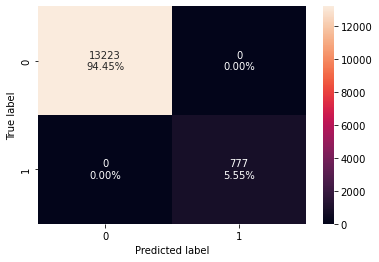

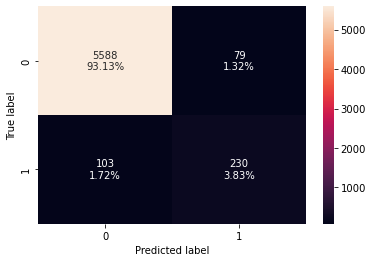

In [23]:
dtree=DecisionTreeClassifier(random_state=1,class_weight='balanced')
dtree.fit(X_train,y_train)

confusion_matrix_sklearn(dtree,X_train,y_train)

confusion_matrix_sklearn(dtree,X_val,y_val)

dtree_pretune = get_metrics_score(dtree, xtest=X_val, ytest=y_val)

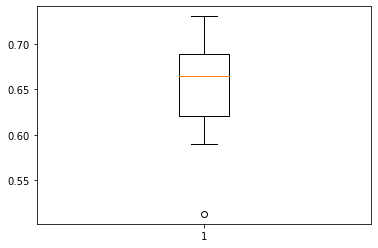

Recall: Mean = 65.0%, Standard Deviation = 6.04%
95% Confidence Interval: 52.91% to 77.08%.


In [24]:
results = cross_val_score(dtree,X_train,y_train,cv=kFold,scoring=scoring)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# Dtree hyperparameter tuning

In [25]:
%%time
# Choose the type of classifier. We're using the decision tree since it's what we created at the start.
dt_estimator = DecisionTreeClassifier(random_state=1,class_weight='balanced')

# Grid of parameters to choose from (these are what we can adjust to look more closely at certain hyperparameter ranges)
    # make sure you don't get too narrow in range with these, the more you have the better the results.
## add from article
parameters = {
            'max_depth': [None]+list(np.arange(2,53,10)), 
            'min_samples_leaf': [0.3,0.5,0.9,1,5,10,20],
            'max_leaf_nodes' : [None,2,5,10],
            'min_impurity_decrease': [0.0, 0.00001, 0.001, 0.1],
            'min_samples_split' : np.arange(2,53,10)
             }

# Type of scoring used to compare parameter combinations
acc_scorer = scoring #we can insert any scoring method we need

# Run the grid search
grid_obj = RandomizedSearchCV(dt_estimator, param_distributions=parameters, 
                              n_iter=1000,scoring=acc_scorer,cv=5,n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
dt_estimator = grid_obj.best_estimator_

# Fit the best algorithm to the data. 
dt_estimator.fit(X_train, y_train)

CPU times: total: 4.14 s
Wall time: 45.4 s


DecisionTreeClassifier(class_weight='balanced', max_depth=2,
                       min_impurity_decrease=0.1, min_samples_leaf=0.5,
                       random_state=1)

In [26]:
grid_obj.best_params_ 

{'min_samples_split': 2,
 'min_samples_leaf': 0.5,
 'min_impurity_decrease': 0.1,
 'max_leaf_nodes': None,
 'max_depth': 2}

    Best Params:
    {'min_samples_split': 2,
     'min_samples_leaf': 0.5,
     'min_impurity_decrease': 0.1,
     'max_leaf_nodes': None,
     'max_depth': 2}

These metrics are performed on the Validation set.

Accuracy on training set :  0.5455
Accuracy on val/test set :  0.534

Recall on training set :  0.9099099099099099
Recall on val/test set :  0.8768768768768769
Precision on training set :  0.101
Precision on val/test set :  0.09583196586806696
F1 on training set :  0.18181818181818182
F1 on val/test set :  0.1727810650887574

Specificity on training set :  0.5240868184224458
Specificity on val/test set :  0.5138521263455091
NPV on training set :  0.99
NPV on val/test set :  0.9861158144260075
Inverted F1 on training set :  0.6853582554517135
Inverted F1 on val/test set :  0.6756380510440837

Harmonic Mean of F1 and Inverted F1 on train set :  0.2873938602220771
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.2751881937926794


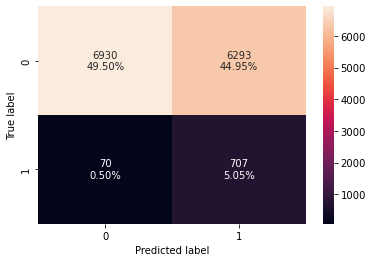

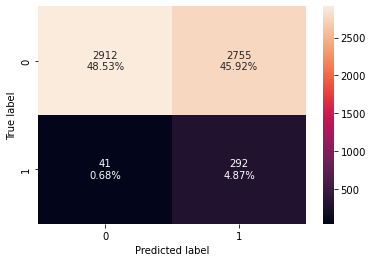

In [27]:
confusion_matrix_sklearn(dt_estimator,X_train,y_train)

confusion_matrix_sklearn(dt_estimator,X_val,y_val)

dtree_posttune = get_metrics_score(dt_estimator, xtest=X_val, ytest=y_val)

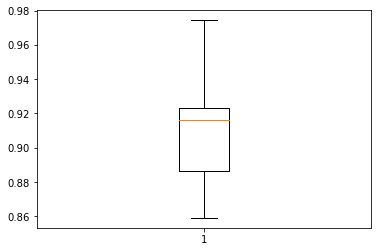

Recall: Mean = 90.99%, Standard Deviation = 3.21%
95% Confidence Interval: 84.57% to 97.41%.


In [28]:
results = cross_val_score(dt_estimator,X_train,y_train,cv=kFold,scoring=scoring)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [29]:
dtree_posttune_test = get_metrics_score(dt_estimator,xtest=X_test,ytest=y_test)

These metrics are performed on the Test set.

Accuracy on training set :  0.5455
Accuracy on val/test set :  0.5556

Recall on training set :  0.9099099099099099
Recall on val/test set :  0.8936170212765957
Precision on training set :  0.101
Precision on val/test set :  0.10310965630114566
F1 on training set :  0.18181818181818182
F1 on val/test set :  0.18488628026412324

Specificity on training set :  0.5240868184224458
Specificity on val/test set :  0.5353963543874523
NPV on training set :  0.99
NPV on val/test set :  0.9882629107981221
Inverted F1 on training set :  0.6853582554517135
Inverted F1 on val/test set :  0.694528457519934

Harmonic Mean of F1 and Inverted F1 on train set :  0.2873938602220771
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.2920323654616097


# Model #2: Random Forest

These metrics are performed on the Validation set.

Accuracy on training set :  0.9999285714285714
Accuracy on val/test set :  0.9821666666666666

Recall on training set :  0.9987129987129987
Recall on val/test set :  0.6846846846846847
Precision on training set :  1.0
Precision on val/test set :  0.991304347826087
F1 on training set :  0.9993560849967803
F1 on val/test set :  0.8099467140319715

Specificity on training set :  1.0
Specificity on val/test set :  0.9996470795835539
NPV on training set :  0.9999243799153055
NPV on val/test set :  0.9818024263431543
Inverted F1 on training set :  0.9999621885279993
Inverted F1 on val/test set :  0.9906443997551806

Harmonic Mean of F1 and Inverted F1 on train set :  0.9996590448907015
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.891228630655934


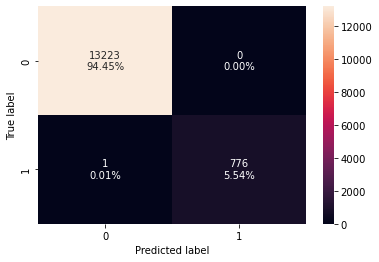

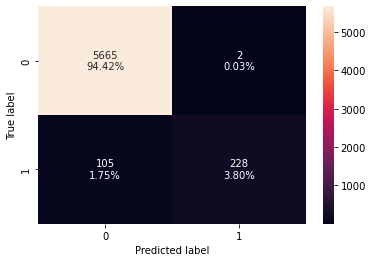

In [30]:
rf_classifier=RandomForestClassifier(random_state=1,class_weight='balanced')
rf_classifier.fit(X_train,y_train)

confusion_matrix_sklearn(rf_classifier,X_train,y_train)

confusion_matrix_sklearn(rf_classifier,X_val,y_val)

rf_classifier_pretune = get_metrics_score(rf_classifier, xtest=X_val, ytest=y_val)

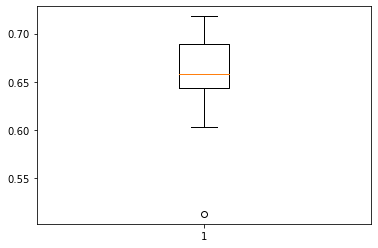

Recall: Mean = 65.26%, Standard Deviation = 5.72%
95% Confidence Interval: 53.81% to 76.71%.


In [31]:
results = cross_val_score(rf_classifier,X_train,y_train,cv=kFold,scoring=scoring)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# Rforest hyperparameter tuning

In [32]:
%%time
# Choose the type of classifier. 
rf_classifier_tuned = RandomForestClassifier(random_state=1,class_weight='balanced')

# Grid of parameters to choose from
## add from article
parameters = {
    "n_estimators": [250],
    "max_depth" : [4],
    "min_samples_leaf": [13,14],
    "max_features": [0.7],
    "max_samples": [None],
    "min_impurity_decrease": [0.0,0.001,0.1,0.000001,0.000000001]
}

# Type of scoring used to compare parameter combinations
acc_scorer = scoring

# Run the grid search
grid_obj = RandomizedSearchCV(rf_classifier_tuned, param_distributions=parameters,
                              n_iter=10,scoring=acc_scorer,cv=15, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
rf_classifier_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
rf_classifier_tuned.fit(X_train, y_train)

CPU times: total: 43.1 s
Wall time: 4min 31s


RandomForestClassifier(class_weight='balanced', max_depth=4, max_features=0.7,
                       min_impurity_decrease=0.001, min_samples_leaf=13,
                       n_estimators=250, random_state=1)

In [33]:
grid_obj.best_params_

{'n_estimators': 250,
 'min_samples_leaf': 13,
 'min_impurity_decrease': 0.001,
 'max_samples': None,
 'max_features': 0.7,
 'max_depth': 4}

    Best Params:
    {'n_estimators': 250,
     'min_samples_leaf': 13,
     'min_impurity_decrease': 0.001,
     'max_samples': None,
     'max_features': 0.7,
     'max_depth': 4}

These metrics are performed on the Validation set.

Accuracy on training set :  0.931
Accuracy on val/test set :  0.9213333333333333

Recall on training set :  0.8893178893178894
Recall on val/test set :  0.8498498498498499
Precision on training set :  0.4398472310630172
Precision on val/test set :  0.4014184397163121
F1 on training set :  0.5885860306643953
F1 on val/test set :  0.5452793834296725

Specificity on training set :  0.933449292898737
Specificity on val/test set :  0.9255337921298747
NPV on training set :  0.993080698366723
NPV on val/test set :  0.9905571293673276
Inverted F1 on training set :  0.9623421175736785
Inverted F1 on val/test set :  0.9569421638387157

Harmonic Mean of F1 and Inverted F1 on train set :  0.7304285859629808
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.6947055632701641


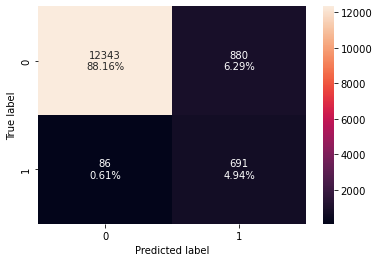

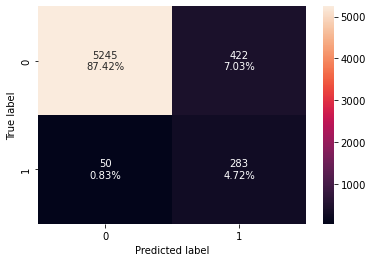

In [34]:
confusion_matrix_sklearn(rf_classifier_tuned,X_train,y_train)

confusion_matrix_sklearn(rf_classifier_tuned,X_val,y_val)

rf_classifier_posttune = get_metrics_score(rf_classifier_tuned, xtest=X_val, ytest=y_val)

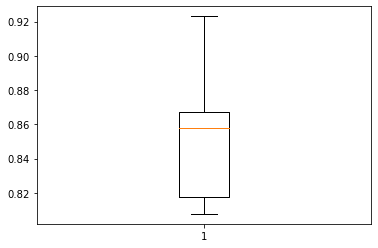

Recall: Mean = 85.47%, Standard Deviation = 3.82%
95% Confidence Interval: 77.82% to 93.11%.


In [35]:
results = cross_val_score(rf_classifier_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [36]:
rf_classifier_posttune_test = get_metrics_score(rf_classifier_tuned,xtest=X_test,ytest=y_test)

These metrics are performed on the Test set.

Accuracy on training set :  0.931
Accuracy on val/test set :  0.9266

Recall on training set :  0.8893178893178894
Recall on val/test set :  0.8156028368794326
Precision on training set :  0.4398472310630172
Precision on val/test set :  0.42201834862385323
F1 on training set :  0.5885860306643953
F1 on val/test set :  0.5562273276904474

Specificity on training set :  0.933449292898737
Specificity on val/test set :  0.9332344213649851
NPV on training set :  0.993080698366723
NPV on val/test set :  0.988327721661055
Inverted F1 on training set :  0.9623421175736785
Inverted F1 on val/test set :  0.9599912787528616

Harmonic Mean of F1 and Inverted F1 on train set :  0.7304285859629808
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.7043488073786603


# Model #3: Adaboost

These metrics are performed on the Validation set.

Accuracy on training set :  0.9776428571428571
Accuracy on val/test set :  0.9738333333333333

Recall on training set :  0.667953667953668
Recall on val/test set :  0.6516516516516516
Precision on training set :  0.9041811846689896
Precision on val/test set :  0.8410852713178295
F1 on training set :  0.768319763138416
F1 on val/test set :  0.7343485617597292

Specificity on training set :  0.9958405808061711
Specificity on val/test set :  0.9927651314628552
NPV on training set :  0.9807835542976314
NPV on val/test set :  0.9797979797979798
Inverted F1 on training set :  0.9882547187511727
Inverted F1 on val/test set :  0.9862389341747743

Harmonic Mean of F1 and Inverted F1 on train set :  0.8645185720955376
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.8418556389302774


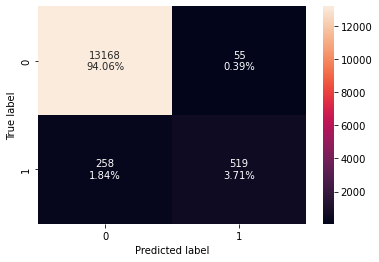

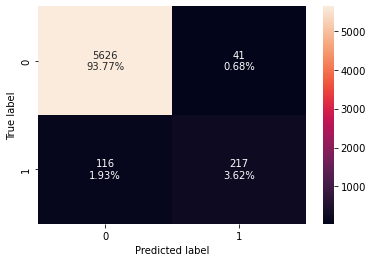

In [37]:
ab_classifier=AdaBoostClassifier(random_state=1)
ab_classifier.fit(X_train,y_train)

confusion_matrix_sklearn(ab_classifier,X_train,y_train)

confusion_matrix_sklearn(ab_classifier,X_val,y_val)

ab_classifier_pretune = get_metrics_score(ab_classifier, xtest=X_val, ytest=y_val)

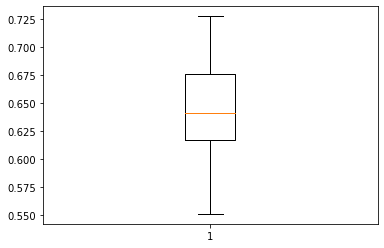

Recall: Mean = 64.5%, Standard Deviation = 5.17%
95% Confidence Interval: 54.15% to 74.84%.


In [38]:
results = cross_val_score(ab_classifier,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# Adaboost (base estimator = best decision tree) hyperparameter tuning

In [39]:
%%time
# Choose the type of classifier. 
ab_classifier_tuned = AdaBoostClassifier(random_state=1,base_estimator=DecisionTreeClassifier(
                    class_weight='balanced',
                    random_state=1,
                    min_samples_split= 52,
                    min_samples_leaf= 0.5,
                    min_impurity_decrease= 1e-05,
                    max_leaf_nodes= 10,
                    max_depth= 52))

# Grid of parameters to choose from
## add from article
parameters = {
    "n_estimators": [50,80],
    "learning_rate": [0.5,0.7,1]
}

# Type of scoring used to compare parameter combinations
acc_scorer = scoring

# Run the grid search
grid_obj = GridSearchCV(ab_classifier_tuned, parameters, scoring=acc_scorer,cv=5, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
ab_classifier_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
ab_classifier_tuned.fit(X_train, y_train)

CPU times: total: 4.77 s
Wall time: 11.9 s


AdaBoostClassifier(base_estimator=DecisionTreeClassifier(class_weight='balanced',
                                                         max_depth=52,
                                                         max_leaf_nodes=10,
                                                         min_impurity_decrease=1e-05,
                                                         min_samples_leaf=0.5,
                                                         min_samples_split=52,
                                                         random_state=1),
                   learning_rate=0.5, random_state=1)

In [40]:
grid_obj.best_params_

{'learning_rate': 0.5, 'n_estimators': 50}

These metrics are performed on the Validation set.

Accuracy on training set :  0.8089285714285714
Accuracy on val/test set :  0.7866666666666666

Recall on training set :  0.8738738738738738
Recall on val/test set :  0.8138138138138138
Precision on training set :  0.20853808353808354
Precision on val/test set :  0.18200134318334452
F1 on training set :  0.3367220431440615
F1 on val/test set :  0.2974753018660812

Specificity on training set :  0.8051123043182333
Specificity on val/test set :  0.7850714663843303
NPV on training set :  0.9908786299329858
NPV on val/test set :  0.9862558191088451
Inverted F1 on training set :  0.8883882004422747
Inverted F1 on val/test set :  0.874238553743368

Harmonic Mean of F1 and Inverted F1 on train set :  0.4883477083373481
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.4439042457896107


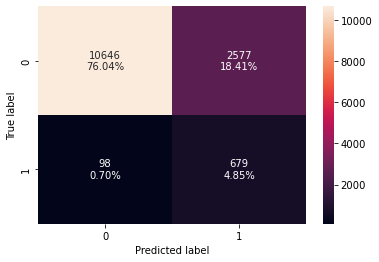

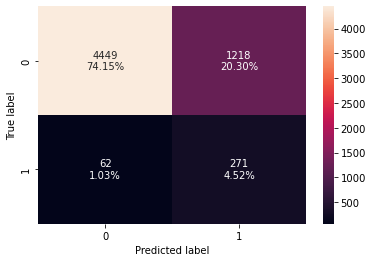

In [41]:
confusion_matrix_sklearn(ab_classifier_tuned,X_train,y_train)

confusion_matrix_sklearn(ab_classifier_tuned,X_val,y_val)

ab_classifier_posttune = get_metrics_score(ab_classifier_tuned, xtest=X_val, ytest=y_val)

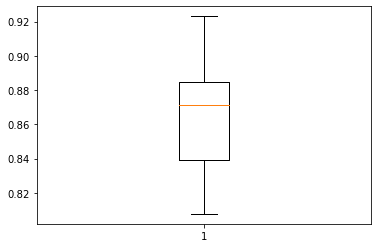

Recall: Mean = 86.75%, Standard Deviation = 3.43%
95% Confidence Interval: 79.9% to 93.6%.
CPU times: total: 21.2 s
Wall time: 21.2 s


In [42]:
%%time
results = cross_val_score(ab_classifier_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [43]:
ab_classifier_posttune_test = get_metrics_score(ab_classifier_tuned,xtest=X_test,ytest=y_test)

These metrics are performed on the Test set.

Accuracy on training set :  0.8089285714285714
Accuracy on val/test set :  0.799

Recall on training set :  0.8738738738738738
Recall on val/test set :  0.8049645390070922
Precision on training set :  0.20853808353808354
Precision on val/test set :  0.19286321155480035
F1 on training set :  0.3367220431440615
F1 on val/test set :  0.31117203564084994

Specificity on training set :  0.8051123043182333
Specificity on val/test set :  0.7986434930055109
NPV on training set :  0.9908786299329858
NPV on val/test set :  0.985613392623594
Inverted F1 on training set :  0.8883882004422747
Inverted F1 on val/test set :  0.8823322795925537

Harmonic Mean of F1 and Inverted F1 on train set :  0.4883477083373481
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.4600856956244078


# Model #4: Gradientboost

These metrics are performed on the Validation set.

Accuracy on training set :  0.9894285714285714
Accuracy on val/test set :  0.9816666666666667

Recall on training set :  0.8223938223938224
Recall on val/test set :  0.7357357357357357
Precision on training set :  0.9845916795069337
Precision on val/test set :  0.9176029962546817
F1 on training set :  0.8962131837307152
F1 on val/test set :  0.8166666666666667

Specificity on training set :  0.9992437419647584
Specificity on val/test set :  0.996117875419093
NPV on training set :  0.9896636956033256
NPV on val/test set :  0.9846502703645561
Inverted F1 on training set :  0.9944306464965756
Inverted F1 on val/test set :  0.9903508771929825

Harmonic Mean of F1 and Inverted F1 on train set :  0.9427707550701899
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.8951618122977347


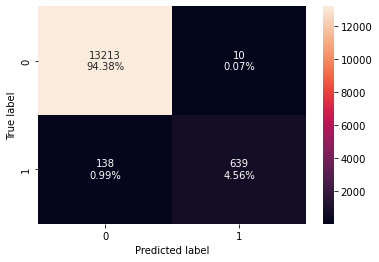

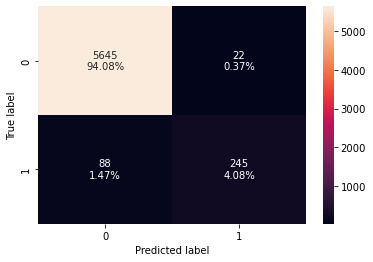

In [44]:
gb_classifier=GradientBoostingClassifier(random_state=1)
gb_classifier.fit(X_train,y_train)

confusion_matrix_sklearn(gb_classifier,X_train,y_train)

confusion_matrix_sklearn(gb_classifier,X_val,y_val)

gb_classifier_pretune = get_metrics_score(gb_classifier, xtest=X_val, ytest=y_val)

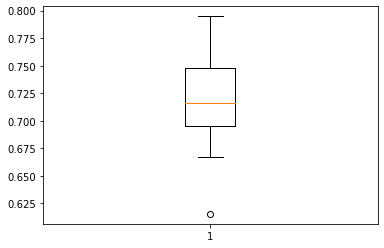

Recall: Mean = 71.44%, Standard Deviation = 4.76%
95% Confidence Interval: 61.92% to 80.96%.


In [45]:
results = cross_val_score(gb_classifier,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# Gradientboost hyperparameter tuning

In [46]:
%%time
# Choose the type of classifier. 
gb_classifier_tuned = GradientBoostingClassifier(random_state=1)

# Grid of parameters to choose from
## add from article
parameters = {
    "n_estimators": [260,255,265],
    "subsample":[1.0],
    "max_features":[0.85,0.9],
    "learning_rate" : [0.3,0.2,0.25]
}

# Type of scoring used to compare parameter combinations
acc_scorer = scoring

# Run the grid search
grid_obj = RandomizedSearchCV(gb_classifier_tuned, param_distributions=parameters, scoring=acc_scorer,
                        n_iter=18,cv=5, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
gb_classifier_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
gb_classifier_tuned.fit(X_train, y_train)

CPU times: total: 1min 1s
Wall time: 3min 59s


GradientBoostingClassifier(learning_rate=0.25, max_features=0.85,
                           n_estimators=265, random_state=1)

In [47]:
best1=grid_obj.best_params_
best1

{'subsample': 1.0,
 'n_estimators': 265,
 'max_features': 0.85,
 'learning_rate': 0.25}

    Best Params:
    {'subsample': 1.0,
     'n_estimators': 265,
     'max_features': 0.85,
     'learning_rate': 0.25}

These metrics are performed on the Validation set.

Accuracy on training set :  1.0
Accuracy on val/test set :  0.9806666666666667

Recall on training set :  1.0
Recall on val/test set :  0.7957957957957958
Precision on training set :  1.0
Precision on val/test set :  0.8466453674121406
F1 on training set :  1.0
F1 on val/test set :  0.8204334365325078

Specificity on training set :  1.0
Specificity on val/test set :  0.9915299100052938
NPV on training set :  1.0
NPV on val/test set :  0.9880429048707579
Inverted F1 on training set :  1.0
Inverted F1 on val/test set :  0.9897833362691563

Harmonic Mean of F1 and Inverted F1 on train set :  1.0
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.8971868520929751


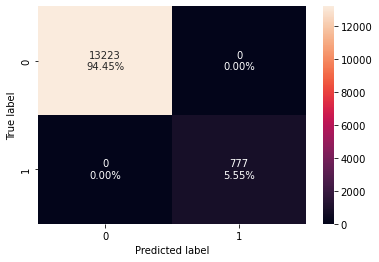

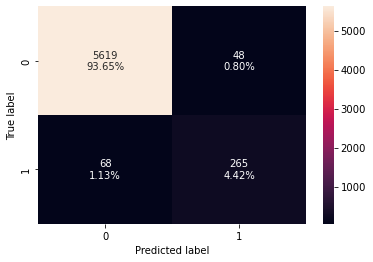

In [48]:
confusion_matrix_sklearn(gb_classifier_tuned,X_train,y_train)

confusion_matrix_sklearn(gb_classifier_tuned,X_val,y_val)

gb_classifier_posttune = get_metrics_score(gb_classifier_tuned, xtest=X_val, ytest=y_val)

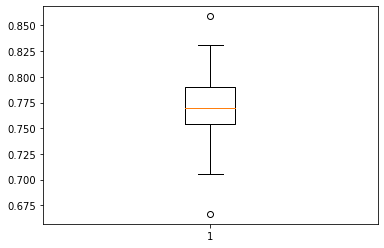

Recall: Mean = 76.84%, Standard Deviation = 5.26%
95% Confidence Interval: 66.33% to 87.35%.


In [49]:
results = cross_val_score(gb_classifier_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [50]:
gb_classifier_posttune_test = get_metrics_score(gb_classifier_tuned,xtest=X_test,ytest=y_test)

These metrics are performed on the Test set.

Accuracy on training set :  1.0
Accuracy on val/test set :  0.9818

Recall on training set :  1.0
Recall on val/test set :  0.7872340425531915
Precision on training set :  1.0
Precision on val/test set :  0.8774703557312253
F1 on training set :  1.0
F1 on val/test set :  0.8299065420560748

Specificity on training set :  1.0
Specificity on val/test set :  0.993429419245443
NPV on training set :  1.0
NPV on val/test set :  0.9873604381714767
Inverted F1 on training set :  1.0
Inverted F1 on val/test set :  0.9903856312731114

Harmonic Mean of F1 and Inverted F1 on train set :  1.0
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.9030720744666424


# Model #5: XGBoost

These metrics are performed on the Validation set.

Accuracy on training set :  1.0
Accuracy on val/test set :  0.989

Recall on training set :  1.0
Recall on val/test set :  0.8198198198198198
Precision on training set :  1.0
Precision on val/test set :  0.978494623655914
F1 on training set :  1.0
F1 on val/test set :  0.892156862745098

Specificity on training set :  1.0
Specificity on val/test set :  0.9989412387506618
NPV on training set :  1.0
NPV on val/test set :  0.989512323020451
Inverted F1 on training set :  1.0
Inverted F1 on val/test set :  0.994204425711275

Harmonic Mean of F1 and Inverted F1 on train set :  1.0
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.9404203816074831


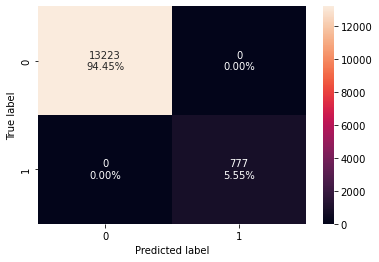

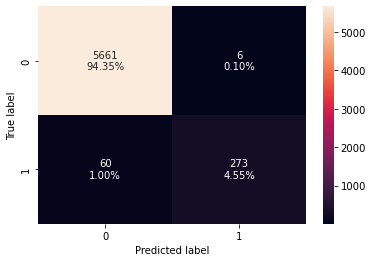

In [51]:
xgb_classifier=XGBClassifier(random_state=1)
xgb_classifier.fit(X_train,y_train)

confusion_matrix_sklearn(xgb_classifier,X_train,y_train)

confusion_matrix_sklearn(xgb_classifier,X_val,y_val)

xgb_classifier_pretune = get_metrics_score(xgb_classifier, xtest=X_val, ytest=y_val)

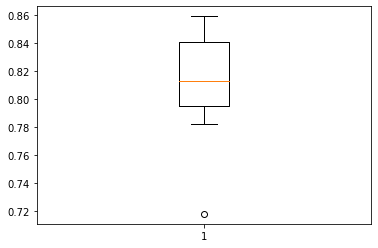

Recall: Mean = 80.96%, Standard Deviation = 3.89%
95% Confidence Interval: 73.17% to 88.75%.


In [52]:
results = cross_val_score(xgb_classifier,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# XGBoost hyperparameter tuning

In [53]:
%%time
# Choose the type of classifier. 
xgb_classifier_tuned = XGBClassifier(random_state=1)

# Grid of parameters to choose from
## add from
parameters = {
    "eval_metric" : ['logloss'], #rmse for Regression, logloss for Classification
    "n_estimators": [80],
    "scale_pos_weight":[2],
    "subsample":[0.65],
    "learning_rate":[0.3,0.4],
    "gamma":[0], #higher gamma = better protection from overfitting
    "colsample_bytree":[0.6,0.8],
    "colsample_bylevel":[0.6,0.9],
    "colsample_bynode": [0.65,0.7],
}

# Type of scoring used to compare parameter combinations
acc_scorer = scoring

# Run the grid search
grid_obj = RandomizedSearchCV(xgb_classifier_tuned, param_distributions=parameters,
                              n_iter=16,scoring=acc_scorer,cv=15, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
xgb_classifier_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
xgb_classifier_tuned.fit(X_train, y_train)

CPU times: total: 14.4 s
Wall time: 46.2 s


XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=0.9, colsample_bynode=0.65,
              colsample_bytree=0.8, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='logloss', gamma=0,
              gpu_id=-1, grow_policy='depthwise', importance_type=None,
              interaction_constraints='', learning_rate=0.4, max_bin=256,
              max_cat_to_onehot=4, max_delta_step=0, max_depth=6, max_leaves=0,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=80, n_jobs=0, num_parallel_tree=1, predictor='auto',
              random_state=1, reg_alpha=0, reg_lambda=1, ...)

In [54]:
grid_obj.best_params_ #0.8198198198198198

{'subsample': 0.65,
 'scale_pos_weight': 2,
 'n_estimators': 80,
 'learning_rate': 0.4,
 'gamma': 0,
 'eval_metric': 'logloss',
 'colsample_bytree': 0.8,
 'colsample_bynode': 0.65,
 'colsample_bylevel': 0.9}

    Best Params:
    {'subsample': 0.65,
     'scale_pos_weight': 2,
     'n_estimators': 80,
     'learning_rate': 0.4,
     'gamma': 0,
     'eval_metric': 'logloss',
     'colsample_bytree': 0.8,
     'colsample_bynode': 0.65,
     'colsample_bylevel': 0.9}

These metrics are performed on the Validation set.

Accuracy on training set :  1.0
Accuracy on val/test set :  0.9885

Recall on training set :  1.0
Recall on val/test set :  0.8198198198198198
Precision on training set :  1.0
Precision on val/test set :  0.9680851063829787
F1 on training set :  1.0
F1 on val/test set :  0.8878048780487804

Specificity on training set :  1.0
Specificity on val/test set :  0.9984118581259925
NPV on training set :  1.0
NPV on val/test set :  0.9895068205666316
Inverted F1 on training set :  1.0
Inverted F1 on val/test set :  0.9939393939393939

Harmonic Mean of F1 and Inverted F1 on train set :  1.0
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.9378790259230164


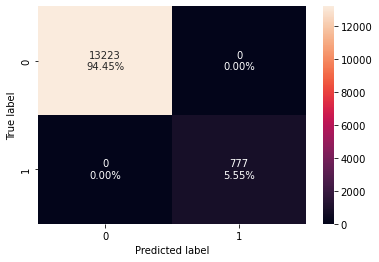

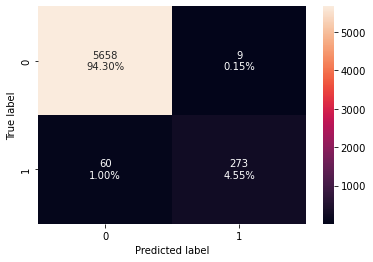

In [55]:
confusion_matrix_sklearn(xgb_classifier_tuned,X_train,y_train)

confusion_matrix_sklearn(xgb_classifier_tuned,X_val,y_val)

xgb_classifier_posttune = get_metrics_score(xgb_classifier_tuned, xtest=X_val, ytest=y_val)

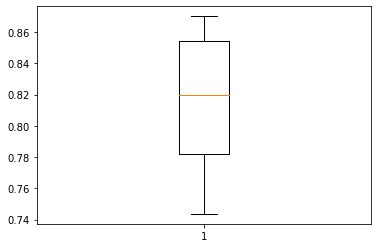

Recall: Mean = 81.48%, Standard Deviation = 4.28%
95% Confidence Interval: 72.92% to 90.05%.


In [56]:
results = cross_val_score(xgb_classifier_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [57]:
xgb_classifier_posttune_test = get_metrics_score(xgb_classifier_tuned,xtest=X_test,ytest=y_test)

These metrics are performed on the Test set.

Accuracy on training set :  1.0
Accuracy on val/test set :  0.9872

Recall on training set :  1.0
Recall on val/test set :  0.8014184397163121
Precision on training set :  1.0
Precision on val/test set :  0.9658119658119658
F1 on training set :  1.0
F1 on val/test set :  0.875968992248062

Specificity on training set :  1.0
Specificity on val/test set :  0.9983043662568886
NPV on training set :  1.0
NPV on val/test set :  0.9882501049097776
Inverted F1 on training set :  1.0
Inverted F1 on val/test set :  0.9932517924926193

Harmonic Mean of F1 and Inverted F1 on train set :  1.0
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.9309309834568792


# Model #6: LogisticRegression

These metrics are performed on the Validation set.

Accuracy on training set :  0.8684285714285714
Accuracy on val/test set :  0.8565

Recall on training set :  0.8661518661518661
Recall on val/test set :  0.8498498498498499
Precision on training set :  0.2791372874326006
Precision on val/test set :  0.2586837294332724
F1 on training set :  0.4222082810539523
F1 on val/test set :  0.3966362999299229

Specificity on training set :  0.8685623534750057
Specificity on val/test set :  0.8568907711311099
NPV on training set :  0.9910259729053412
NPV on val/test set :  0.9898083978801467
Inverted F1 on training set :  0.9257617281960342
Inverted F1 on val/test set :  0.9185661590844605

Harmonic Mean of F1 and Inverted F1 on train set :  0.5799302139439461
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.5540389315469139


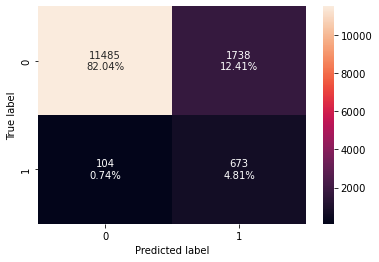

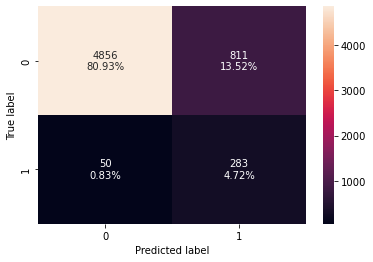

In [58]:
Log = LogisticRegression(random_state=1,max_iter=1200,class_weight='balanced',
    penalty='l2',solver='saga') 
    #only increase max_iter if warning is thrown)
    #Check shift-tab for optimal Penalty and Solver
Log.fit(X_train, y_train)

confusion_matrix_sklearn(Log,X_train,y_train)

confusion_matrix_sklearn(Log,X_val,y_val)

Log_pretune = get_metrics_score(Log, xtest=X_val, ytest=y_val)

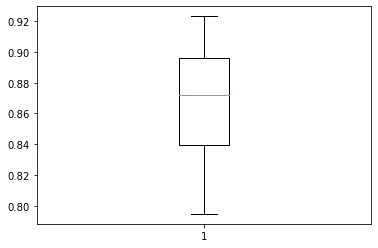

Recall: Mean = 86.75%, Standard Deviation = 3.64%
95% Confidence Interval: 79.47% to 94.04%.


In [59]:
results = cross_val_score(Log,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)


plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# The model isn't overfit, so there's no point in tuning lambda/"C".

In [60]:
Log_posttune_test = get_metrics_score(Log,xtest=X_test,ytest=y_test)

These metrics are performed on the Test set.

Accuracy on training set :  0.8684285714285714
Accuracy on val/test set :  0.8662

Recall on training set :  0.8661518661518661
Recall on val/test set :  0.8120567375886525
Precision on training set :  0.2791372874326006
Precision on val/test set :  0.2710059171597633
F1 on training set :  0.4222082810539523
F1 on val/test set :  0.40638864241348704

Specificity on training set :  0.8685623534750057
Specificity on val/test set :  0.8694362017804155
NPV on training set :  0.9910259729053412
NPV on val/test set :  0.9872442839951865
Inverted F1 on training set :  0.9257617281960342
Inverted F1 on val/test set :  0.9246027273751832

Harmonic Mean of F1 and Inverted F1 on train set :  0.5799302139439461
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.5646137994260144


## All test results for original model:::

In [61]:
list_of_test_results=[
    dtree_posttune_test,
    rf_classifier_posttune_test,
    ab_classifier_posttune_test,
    gb_classifier_posttune_test,
    xgb_classifier_posttune_test,
    Log_posttune_test
]

list_=[]
for entry in list_of_test_results:
    list_.append([entry[2],entry[3]])
    
Metrics=pd.DataFrame(list_,index=['dtree','rf','ab','gb','xgb','log'],columns=['train_recall','test_recall']).sort_values('test_recall',ascending=False)
Metrics

,train_recall,test_recall
dtree,0.909910,0.893617
rf,0.889318,0.815603
log,0.866152,0.812057
ab,0.873874,0.804965
xgb,1.000000,0.801418
gb,1.000000,0.787234


# Our models (aside from the dtree) seem extremely overfit. 
### Dtree is unfortunately extremely inaccurate. Around 55% accuracy on the test set, which means the model will return 'failing machine' on around half of all inputs. This is not great for a model that is attempting to reduce costs WHILE predicting failures.
# We need to deal with the imbalance in the data.

---
---
---
# Model Building with Oversampled data


In [62]:
# Fit SMOTE on train data(Synthetic Minority Oversampling TEchnique)
sm = SMOTE(sampling_strategy=1.0, k_neighbors=40, random_state=1)
    # sampling_strategy: bring the Minority class up to this ratio
    # k_neighbors: How many neighbors to look for to generate synthetic data
X_train_SMOTE, y_train_SMOTE = sm.fit_resample(X_train, y_train)

# SMOTE Model #1: Decision Tree

These metrics are performed on the Validation set.

Accuracy on training set :  1.0
Accuracy on val/test set :  0.9423333333333334

Recall on training set :  1.0
Recall on val/test set :  0.8438438438438438
Precision on training set :  1.0
Precision on val/test set :  0.48869565217391303
F1 on training set :  1.0
F1 on val/test set :  0.6189427312775331

Specificity on training set :  1.0
Specificity on val/test set :  0.9481206987824246
NPV on training set :  1.0
NPV on val/test set :  0.9904147465437788
Inverted F1 on training set :  1.0
Inverted F1 on val/test set :  0.9688063469166968

Harmonic Mean of F1 and Inverted F1 on train set :  1.0
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.7553279730089391


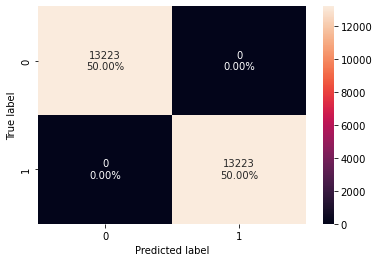

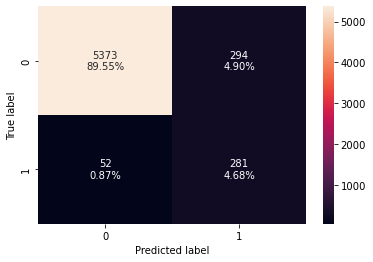

In [64]:
dtree_SMOTE=DecisionTreeClassifier(random_state=1)
dtree_SMOTE.fit(X_train_SMOTE,y_train_SMOTE)

confusion_matrix_sklearn(dtree_SMOTE,X_train_SMOTE,y_train_SMOTE)

confusion_matrix_sklearn(dtree_SMOTE,X_val,y_val)

dtree_pretune = get_metrics_score(dtree_SMOTE,X_train=X_train_SMOTE,y_train=y_train_SMOTE,
                                  xtest=X_val, ytest=y_val)

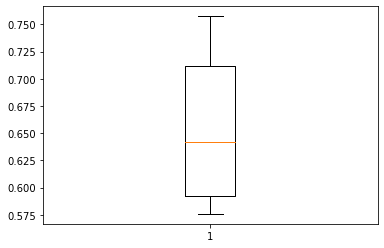

Recall: Mean = 65.16%, Standard Deviation = 6.48%
95% Confidence Interval: 52.19% to 78.13%.


In [65]:
results = cross_val_score(dtree_SMOTE,X_val,y_val,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

## Unfortunately, we are heavily overfit. The cross validation is also completely inaccurate, due to us making cross_val_splits on data which has already been SMOTE'd.

## In order to make sure we aren't GridSearch hyperparameter tuning solely to our SMOTE'd data, we need to make sure our cross validation splits occur BEFORE the SMOTE fit.

In [66]:
from imblearn.pipeline import make_pipeline as make_imb_pipeline

These metrics are performed on the Validation set.

Accuracy on training set :  1.0
Accuracy on val/test set :  0.9423333333333334

Recall on training set :  1.0
Recall on val/test set :  0.8438438438438438
Precision on training set :  1.0
Precision on val/test set :  0.48869565217391303
F1 on training set :  1.0
F1 on val/test set :  0.6189427312775331

Specificity on training set :  1.0
Specificity on val/test set :  0.9481206987824246
NPV on training set :  1.0
NPV on val/test set :  0.9904147465437788
Inverted F1 on training set :  1.0
Inverted F1 on val/test set :  0.9688063469166968

Harmonic Mean of F1 and Inverted F1 on train set :  1.0
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.7553279730089391


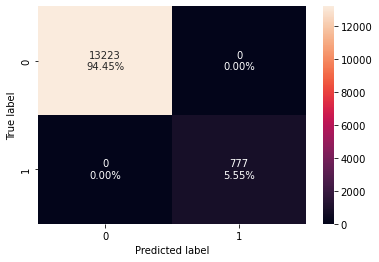

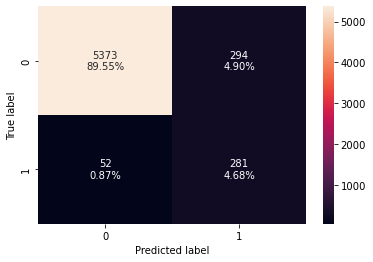

In [67]:
dtree_SMOTE = make_imb_pipeline(sm,DecisionTreeClassifier(random_state=1))
dtree_SMOTE.fit(X_train,y_train)

confusion_matrix_sklearn(dtree_SMOTE,X_train,y_train)

confusion_matrix_sklearn(dtree_SMOTE,X_val,y_val)

dtree_SMOTE_pretune = get_metrics_score(dtree_SMOTE, xtest=X_val, ytest=y_val)

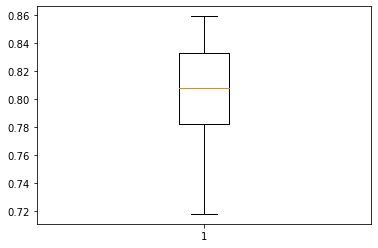

Recall: Mean = 80.05%, Standard Deviation = 4.65%
95% Confidence Interval: 70.76% to 89.35%.


In [68]:
results = cross_val_score(dtree_SMOTE,X_train,y_train,cv=kFold,scoring=scoring)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

## The kFold cross validation is much more accurate now, and our GridSearch won't overfit to the resample.
# SMOTE dtree hyperparameter tuning

In [69]:
%%time
# Choose the type of classifier. We're using the decision tree since it's what we created at the start.
dt_estimator_SMOTE = make_imb_pipeline(sm,DecisionTreeClassifier(random_state=1))

# Grid of parameters to choose from (these are what we can adjust to look more closely at certain hyperparameter ranges)
    # make sure you don't get too narrow in range with these, the more you have the better the results.
## add from article
parameters = {'decisiontreeclassifier__max_depth': [5], 
              'decisiontreeclassifier__min_samples_leaf': [1],
              'decisiontreeclassifier__max_leaf_nodes' : [None],
              'decisiontreeclassifier__min_impurity_decrease': [0.0, 0.00000000001],
              'decisiontreeclassifier__min_samples_split' : [6]
             }

# Type of scoring used to compare parameter combinations
acc_scorer = scoring #we can insert any scoring method we need

# Run the grid search
grid_obj = RandomizedSearchCV(dt_estimator_SMOTE, param_distributions=parameters,
                              n_iter=2,scoring=acc_scorer,cv=15,n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
dt_estimator_SMOTE = grid_obj.best_estimator_

# Fit the best algorithm to the data. 
dt_estimator_SMOTE.fit(X_train, y_train)

CPU times: total: 2.52 s
Wall time: 3 s


Pipeline(steps=[('smote',
                 SMOTE(k_neighbors=40, random_state=1, sampling_strategy=1.0)),
                ('decisiontreeclassifier',
                 DecisionTreeClassifier(max_depth=5, min_samples_split=6,
                                        random_state=1))])

In [70]:
grid_obj.best_params_ #0.8828828828828829

{'decisiontreeclassifier__min_samples_split': 6,
 'decisiontreeclassifier__min_samples_leaf': 1,
 'decisiontreeclassifier__min_impurity_decrease': 0.0,
 'decisiontreeclassifier__max_leaf_nodes': None,
 'decisiontreeclassifier__max_depth': 5}

    Best Params:
    {'decisiontreeclassifier__min_samples_split': 6,
     'decisiontreeclassifier__min_samples_leaf': 1,
     'decisiontreeclassifier__min_impurity_decrease': 0.0,
     'decisiontreeclassifier__max_leaf_nodes': None,
     'decisiontreeclassifier__max_depth': 5}

These metrics are performed on the Validation set.

Accuracy on training set :  0.8927142857142857
Accuracy on val/test set :  0.8806666666666667

Recall on training set :  0.9099099099099099
Recall on val/test set :  0.8648648648648649
Precision on training set :  0.33052828424497427
Precision on val/test set :  0.30031282586027114
F1 on training set :  0.4849108367626886
F1 on val/test set :  0.44582043343653255

Specificity on training set :  0.8917038493533994
Specificity on val/test set :  0.8815952002823363
NPV on training set :  0.9940983053705421
NPV on val/test set :  0.991073199761952
Inverted F1 on training set :  0.9401211927922182
Inverted F1 on val/test set :  0.9331341053418004

Harmonic Mean of F1 and Inverted F1 on train set :  0.6398101162646835
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.6033705094679211


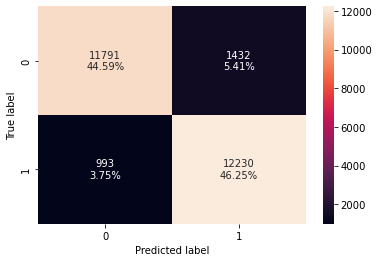

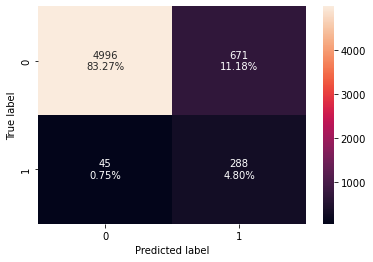

In [71]:
confusion_matrix_sklearn(dt_estimator_SMOTE,X_train_SMOTE,y_train_SMOTE)

confusion_matrix_sklearn(dt_estimator_SMOTE,X_val,y_val)

dtree_posttune = get_metrics_score(dt_estimator_SMOTE,xtest=X_val, ytest=y_val)

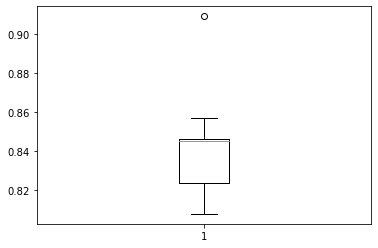

Recall: Mean = 84.31%, Standard Deviation = 2.64%
95% Confidence Interval: 79.04% to 89.58%.


In [72]:
results = cross_val_score(dt_estimator_SMOTE,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [73]:
dtreeSMOTE_posttune_test = get_metrics_score(dt_estimator_SMOTE,xtest=X_test, ytest=y_test)

These metrics are performed on the Test set.

Accuracy on training set :  0.8927142857142857
Accuracy on val/test set :  0.8888

Recall on training set :  0.9099099099099099
Recall on val/test set :  0.8191489361702128
Precision on training set :  0.33052828424497427
Precision on val/test set :  0.3138586956521739
F1 on training set :  0.4849108367626886
F1 on val/test set :  0.45383104125736734

Specificity on training set :  0.8917038493533994
Specificity on val/test set :  0.8929631199660873
NPV on training set :  0.9940983053705421
NPV on val/test set :  0.9880393996247655
Inverted F1 on training set :  0.9401211927922182
Inverted F1 on val/test set :  0.9380984190603429

Harmonic Mean of F1 and Inverted F1 on train set :  0.6398101162646835
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.6117237898346805


# SMOTE Model #2: Random Forest

These metrics are performed on the Validation set.

Accuracy on training set :  1.0
Accuracy on val/test set :  0.985

Recall on training set :  1.0
Recall on val/test set :  0.8588588588588588
Precision on training set :  1.0
Precision on val/test set :  0.8693009118541033
F1 on training set :  1.0
F1 on val/test set :  0.86404833836858

Specificity on training set :  1.0
Specificity on val/test set :  0.9924122110464091
NPV on training set :  1.0
NPV on val/test set :  0.9917122200670075
Inverted F1 on training set :  1.0
Inverted F1 on val/test set :  0.992062092079732

Harmonic Mean of F1 and Inverted F1 on train set :  1.0
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.9236407361957553


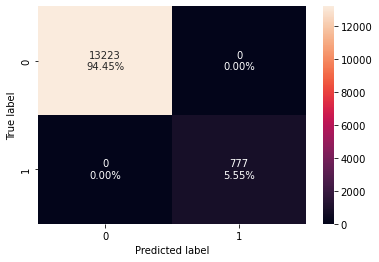

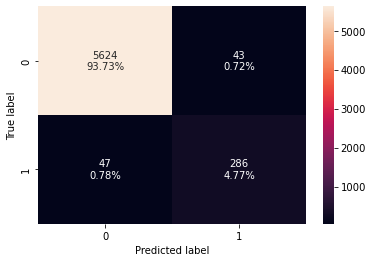

In [74]:
rf_SMOTE_classifier = make_imb_pipeline(sm,RandomForestClassifier(random_state=1))
rf_SMOTE_classifier.fit(X_train,y_train)

confusion_matrix_sklearn(rf_SMOTE_classifier,X_train,y_train)

confusion_matrix_sklearn(rf_SMOTE_classifier,X_val,y_val)

rf_classifier_posttune = get_metrics_score(rf_SMOTE_classifier, xtest=X_val, ytest=y_val)

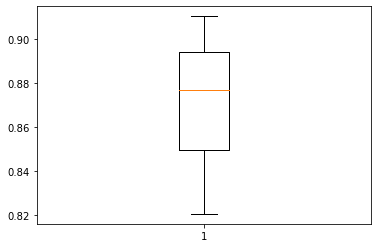

Recall: Mean = 87.01%, Standard Deviation = 3.14%
95% Confidence Interval: 80.72% to 93.29%.


In [75]:
results = cross_val_score(rf_SMOTE_classifier,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# SMOTE RF hyperparameter tuning

In [76]:
%%time
# Choose the type of classifier. 
rf_classifier_SMOTE_tuned = make_imb_pipeline(sm,RandomForestClassifier(random_state=1))

# Grid of parameters to choose from
## add from article
parameters = {
    "randomforestclassifier__n_estimators": [50,150],
    "randomforestclassifier__max_depth" : [5],
    "randomforestclassifier__min_samples_leaf": np.arange(4,10,3),
    "randomforestclassifier__max_features": ['sqrt',0.7,1],
    "randomforestclassifier__max_samples": [0.3,0.7],
    "randomforestclassifier__min_impurity_decrease": [0.0,0.001,0.1,0.000001]
}

# Type of scoring used to compare parameter combinations
acc_scorer = scoring

# Run the grid search
grid_obj = RandomizedSearchCV(rf_classifier_SMOTE_tuned, param_distributions=parameters,
                              n_iter=96,scoring=acc_scorer,cv=5, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
rf_classifier_SMOTE_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
rf_classifier_SMOTE_tuned.fit(X_train, y_train)

CPU times: total: 19.1 s
Wall time: 2min 37s


Pipeline(steps=[('smote',
                 SMOTE(k_neighbors=40, random_state=1, sampling_strategy=1.0)),
                ('randomforestclassifier',
                 RandomForestClassifier(max_depth=5, max_features=0.7,
                                        max_samples=0.7, min_samples_leaf=7,
                                        n_estimators=50, random_state=1))])

In [77]:
grid_obj.best_params_

{'randomforestclassifier__n_estimators': 50,
 'randomforestclassifier__min_samples_leaf': 7,
 'randomforestclassifier__min_impurity_decrease': 0.0,
 'randomforestclassifier__max_samples': 0.7,
 'randomforestclassifier__max_features': 0.7,
 'randomforestclassifier__max_depth': 5}

    Best Params:
    {'randomforestclassifier__n_estimators': 50,
     'randomforestclassifier__min_samples_leaf': 7,
     'randomforestclassifier__min_impurity_decrease': 0.0,
     'randomforestclassifier__max_samples': 0.7,
     'randomforestclassifier__max_features': 0.7,
     'randomforestclassifier__max_depth': 5}
     

These metrics are performed on the Validation set.

Accuracy on training set :  0.9263571428571429
Accuracy on val/test set :  0.9155

Recall on training set :  0.9111969111969112
Recall on val/test set :  0.8768768768768769
Precision on training set :  0.4239520958083832
Precision on val/test set :  0.38522427440633245
F1 on training set :  0.5786677564364527
F1 on val/test set :  0.5352887259395049

Specificity on training set :  0.9272479770097557
Specificity on val/test set :  0.9177695429680607
NPV on training set :  0.994403892944039
NPV on val/test set :  0.9921785578023655
Inverted F1 on training set :  0.9596524869878293
Inverted F1 on val/test set :  0.9535246127051058

Harmonic Mean of F1 and Inverted F1 on train set :  0.7219822452154356
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.6856614752680078


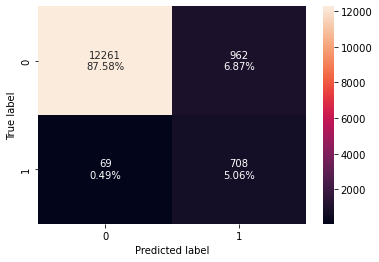

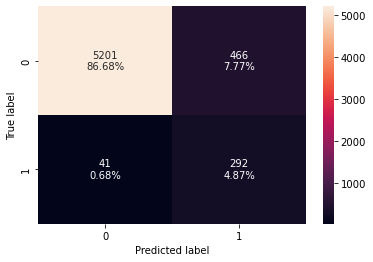

In [78]:
confusion_matrix_sklearn(rf_classifier_SMOTE_tuned,X_train,y_train)

confusion_matrix_sklearn(rf_classifier_SMOTE_tuned,X_val,y_val)

rf_classifier_posttune = get_metrics_score(rf_classifier_SMOTE_tuned, xtest=X_val, ytest=y_val)

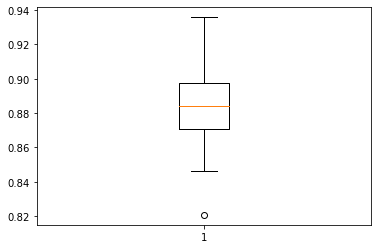

Recall: Mean = 88.29%, Standard Deviation = 3.25%
95% Confidence Interval: 81.78% to 94.8%.


In [79]:
results = cross_val_score(rf_classifier_SMOTE_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [81]:
rf_classifier_SMOTE_posttune_test = get_metrics_score(rf_classifier_SMOTE_tuned)

These metrics are performed on the Test set.

Accuracy on training set :  0.9263571428571429
Accuracy on val/test set :  0.9194

Recall on training set :  0.9111969111969112
Recall on val/test set :  0.8404255319148937
Precision on training set :  0.4239520958083832
Precision on val/test set :  0.3983193277310924
F1 on training set :  0.5786677564364527
F1 on val/test set :  0.540478905359179

Specificity on training set :  0.9272479770097557
Specificity on val/test set :  0.924120389995761
NPV on training set :  0.994403892944039
NPV on val/test set :  0.9897843359818388
Inverted F1 on training set :  0.9596524869878293
Inverted F1 on val/test set :  0.9558259344513865

Harmonic Mean of F1 and Inverted F1 on train set :  0.7219822452154356
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.6905060266083248


# SMOTE Model #3: Adaboost

In [82]:
# Fit SMOTE on train data(Synthetic Minority Oversampling TEchnique)
sm = SMOTE(sampling_strategy=1, k_neighbors=500, random_state=1)
    # sampling_strategy: bring the Minority class up to this ratio
    # k_neighbors: How many neighbors to look for to generate synthetic data

These metrics are performed on the Validation set.

Accuracy on training set :  0.9192142857142858
Accuracy on val/test set :  0.9053333333333333

Recall on training set :  0.8712998712998713
Recall on val/test set :  0.8618618618618619
Precision on training set :  0.39637002341920374
Precision on val/test set :  0.3547589616810878
F1 on training set :  0.5448692152917506
F1 on val/test set :  0.5026269702276708

Specificity on training set :  0.9220297965665886
Specificity on val/test set :  0.9078877713075701
NPV on training set :  0.9918646273999349
NPV on val/test set :  0.9911385089578116
Inverted F1 on training set :  0.9556731334509113
Inverted F1 on val/test set :  0.9476883403941795

Harmonic Mean of F1 and Inverted F1 on train set :  0.6940382198944627
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.6568691866711093


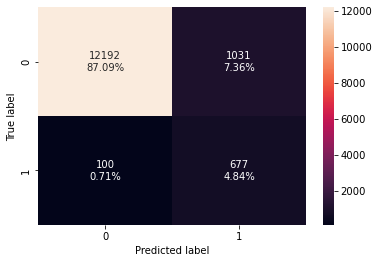

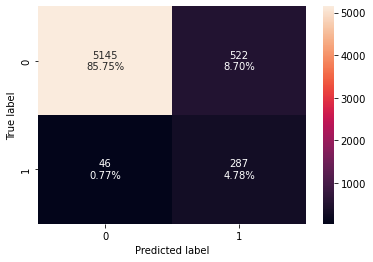

In [83]:
ab_classifier_SMOTE= make_imb_pipeline(sm,AdaBoostClassifier(random_state=1))
ab_classifier_SMOTE.fit(X_train,y_train)

confusion_matrix_sklearn(ab_classifier_SMOTE,X_train,y_train)

confusion_matrix_sklearn(ab_classifier_SMOTE,X_val,y_val)

ab_classifier_pretune = get_metrics_score(ab_classifier_SMOTE, xtest=X_val, ytest=y_val)

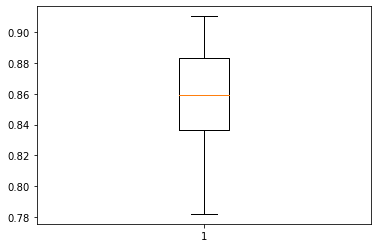

Recall: Mean = 85.6%, Standard Deviation = 3.54%
95% Confidence Interval: 78.52% to 92.67%.


In [84]:
results = cross_val_score(ab_classifier_SMOTE,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# SMOTE Adaboost hyperparameter tuning

In [85]:
%%time
# Choose the type of classifier. 
ab_classifier_SMOTE_tuned = make_imb_pipeline(sm,AdaBoostClassifier(random_state=1))

# Grid of parameters to choose from
## add from article
parameters = {
    "adaboostclassifier__n_estimators": [50,80],
    "adaboostclassifier__learning_rate": [0.5,0.7,1]
}

# Type of scoring used to compare parameter combinations
acc_scorer = scoring

# Run the grid search
grid_obj = GridSearchCV(ab_classifier_SMOTE_tuned, parameters, scoring=acc_scorer,cv=5, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
ab_classifier_SMOTE_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
ab_classifier_SMOTE_tuned.fit(X_train, y_train)

CPU times: total: 19.4 s
Wall time: 34.9 s


Pipeline(steps=[('smote',
                 SMOTE(k_neighbors=500, random_state=1, sampling_strategy=1)),
                ('adaboostclassifier',
                 AdaBoostClassifier(learning_rate=0.7, n_estimators=80,
                                    random_state=1))])

In [86]:
grid_obj.best_params_

{'adaboostclassifier__learning_rate': 0.7,
 'adaboostclassifier__n_estimators': 80}

These metrics are performed on the Validation set.

Accuracy on training set :  0.9285
Accuracy on val/test set :  0.918

Recall on training set :  0.8815958815958816
Recall on val/test set :  0.8528528528528528
Precision on training set :  0.42973651191969886
Precision on val/test set :  0.390646492434663
F1 on training set :  0.5778152678194854
F1 on val/test set :  0.5358490566037736

Specificity on training set :  0.9312561445965364
Specificity on val/test set :  0.9218281277571908
NPV on training set :  0.9925842334354344
NPV on val/test set :  0.9907073772046273
Inverted F1 on training set :  0.9609426821179132
Inverted F1 on val/test set :  0.9550274223034735

Harmonic Mean of F1 and Inverted F1 on train set :  0.7216825144587892
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.6865096478645135


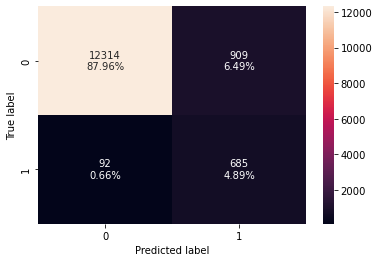

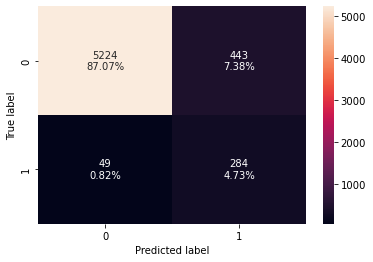

In [87]:
confusion_matrix_sklearn(ab_classifier_SMOTE_tuned,X_train,y_train)

confusion_matrix_sklearn(ab_classifier_SMOTE_tuned,X_val,y_val)

ab_classifier_pretune = get_metrics_score(ab_classifier_SMOTE_tuned, xtest=X_val, ytest=y_val)

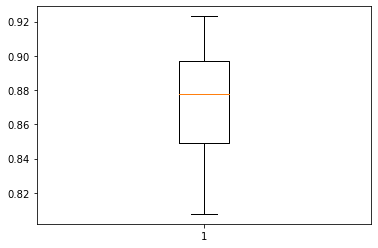

Recall: Mean = 87.01%, Standard Deviation = 3.59%
95% Confidence Interval: 79.83% to 94.18%.


In [88]:
results = cross_val_score(ab_classifier_SMOTE_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [89]:
ab_classifier_SMOTE_posttune_test = get_metrics_score(ab_classifier_SMOTE_tuned)

These metrics are performed on the Test set.

Accuracy on training set :  0.9285
Accuracy on val/test set :  0.9264

Recall on training set :  0.8815958815958816
Recall on val/test set :  0.8368794326241135
Precision on training set :  0.42973651191969886
Precision on val/test set :  0.4229390681003584
F1 on training set :  0.5778152678194854
F1 on val/test set :  0.5619047619047619

Specificity on training set :  0.9312561445965364
Specificity on val/test set :  0.9317507418397626
NPV on training set :  0.9925842334354344
NPV on val/test set :  0.989644304367402
Inverted F1 on training set :  0.9609426821179132
Inverted F1 on val/test set :  0.959825327510917

Harmonic Mean of F1 and Inverted F1 on train set :  0.7216825144587892
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.7088384804591419


# SMOTE Adaboost with random forest base estimator tuning

In [90]:
%%time
# Choose the type of classifier. 
ab_classifier_rf_SMOTE_tuned = make_imb_pipeline(sm,AdaBoostClassifier(random_state=1,base_estimator=RandomForestClassifier(
            random_state=1,
            n_estimators= 150,
            min_samples_leaf= 7,
            min_impurity_decrease= 0.001,
            max_samples= 0.3,
            max_features= 0.7,
            max_depth= 5)))

# Grid of parameters to choose from
## add from article
parameters = {
    "adaboostclassifier__n_estimators": [80],
    "adaboostclassifier__learning_rate": [0.5]
}

# Type of scoring used to compare parameter combinations
acc_scorer = scoring

# Run the grid search
grid_obj = GridSearchCV(ab_classifier_rf_SMOTE_tuned, parameters, scoring=acc_scorer,cv=5, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
ab_classifier_rf_SMOTE_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
ab_classifier_rf_SMOTE_tuned.fit(X_train, y_train)

CPU times: total: 33min 24s
Wall time: 46min 37s


Pipeline(steps=[('smote',
                 SMOTE(k_neighbors=500, random_state=1, sampling_strategy=1)),
                ('adaboostclassifier',
                 AdaBoostClassifier(base_estimator=RandomForestClassifier(max_depth=5,
                                                                          max_features=0.7,
                                                                          max_samples=0.3,
                                                                          min_impurity_decrease=0.001,
                                                                          min_samples_leaf=7,
                                                                          n_estimators=150,
                                                                          random_state=1),
                                    learning_rate=0.5, n_estimators=80,
                                    random_state=1))])

In [91]:
grid_obj.best_params_

{'adaboostclassifier__learning_rate': 0.5,
 'adaboostclassifier__n_estimators': 80}

    Best Params:
    {'adaboostclassifier__learning_rate': 0.5,
     'adaboostclassifier__n_estimators': 80}

These metrics are performed on the Validation set.

Accuracy on training set :  0.999
Accuracy on val/test set :  0.9826666666666667

Recall on training set :  0.9987129987129987
Recall on val/test set :  0.8948948948948949
Precision on training set :  0.9835234474017744
Precision on val/test set :  0.8119891008174387
F1 on training set :  0.9910600255427843
F1 on val/test set :  0.8514285714285714

Specificity on training set :  0.9990168645541859
Specificity on val/test set :  0.9878242456326098
NPV on training set :  0.9999243055029899
NPV on val/test set :  0.9937866145925794
Inverted F1 on training set :  0.9994703790572748
Inverted F1 on val/test set :  0.9907964601769912

Harmonic Mean of F1 and Inverted F1 on train set :  0.9952474346622995
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.915840790557233


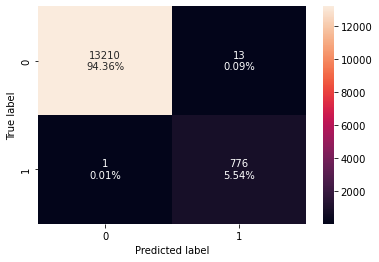

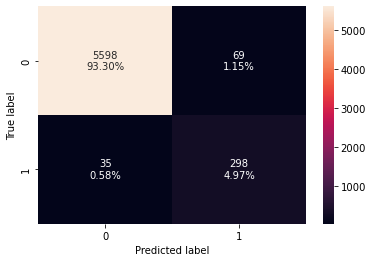

In [92]:
confusion_matrix_sklearn(ab_classifier_rf_SMOTE_tuned,X_train,y_train)

confusion_matrix_sklearn(ab_classifier_rf_SMOTE_tuned,X_val,y_val)

ab_classifier_pretune = get_metrics_score(ab_classifier_rf_SMOTE_tuned, xtest=X_val, ytest=y_val)

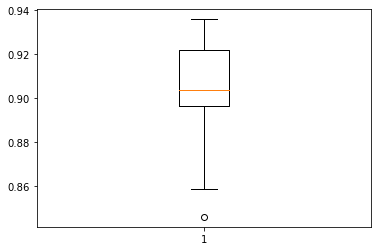

Recall: Mean = 90.09%, Standard Deviation = 2.74%
95% Confidence Interval: 84.62% to 95.57%.


In [93]:
results = cross_val_score(ab_classifier_rf_SMOTE_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [94]:
ab_classifier_rf_SMOTE_posttune_test = get_metrics_score(ab_classifier_rf_SMOTE_tuned)

These metrics are performed on the Test set.

Accuracy on training set :  0.999
Accuracy on val/test set :  0.9812

Recall on training set :  0.9987129987129987
Recall on val/test set :  0.8546099290780141
Precision on training set :  0.9835234474017744
Precision on val/test set :  0.8197278911564626
F1 on training set :  0.9910600255427843
F1 on val/test set :  0.8368055555555556

Specificity on training set :  0.9990168645541859
Specificity on val/test set :  0.9887664264518864
NPV on training set :  0.9999243055029899
NPV on val/test set :  0.9912877178070548
Inverted F1 on training set :  0.9994703790572748
Inverted F1 on val/test set :  0.990025466893039

Harmonic Mean of F1 and Inverted F1 on train set :  0.9952474346622995
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.9069900835460439


# SMOTE Model #4: Gradientboost

In [95]:
# Fit SMOTE on train data(Synthetic Minority Oversampling TEchnique)
sm = SMOTE(sampling_strategy=1, k_neighbors=50, random_state=1)
    # sampling_strategy: bring the Minority class up to this ratio
    # k_neighbors: How many neighbors to look for to generate synthetic data

These metrics are performed on the Validation set.

Accuracy on training set :  0.9715714285714285
Accuracy on val/test set :  0.9578333333333333

Recall on training set :  0.9266409266409267
Recall on val/test set :  0.8828828828828829
Precision on training set :  0.6786050895381716
Precision on val/test set :  0.5787401574803149
F1 on training set :  0.7834602829162133
F1 on val/test set :  0.699167657550535

Specificity on training set :  0.9742116009982607
Specificity on val/test set :  0.9622375154402683
NPV on training set :  0.9955947136563876
NPV on val/test set :  0.9928987618353969
Inverted F1 on training set :  0.9847870957877839
Inverted F1 on val/test set :  0.9773277175374138

Harmonic Mean of F1 and Inverted F1 on train set :  0.8726624859962975
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.815171865170219


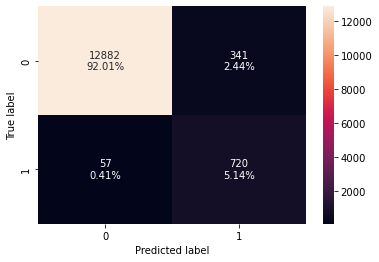

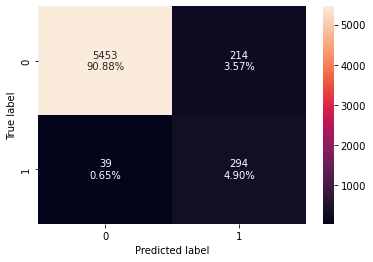

In [96]:
gb_SMOTE_classifier=make_imb_pipeline(sm,GradientBoostingClassifier(random_state=1))
gb_SMOTE_classifier.fit(X_train,y_train)

confusion_matrix_sklearn(gb_SMOTE_classifier,X_train,y_train)

confusion_matrix_sklearn(gb_SMOTE_classifier,X_val,y_val)

gb_classifier_pretune = get_metrics_score(gb_SMOTE_classifier, xtest=X_val, ytest=y_val)

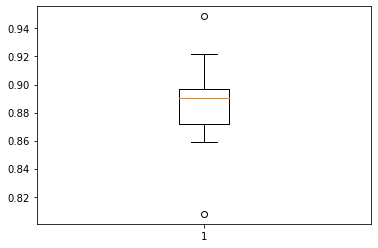

Recall: Mean = 88.55%, Standard Deviation = 3.58%
95% Confidence Interval: 81.39% to 95.72%.


In [97]:
results = cross_val_score(gb_SMOTE_classifier,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# SMOTE Gradientboost hyperparameter tuning

In [98]:
%%time
# Choose the type of classifier. 
gb_SMOTE_classifier_tuned = make_imb_pipeline(sm,GradientBoostingClassifier(random_state=1))

# Grid of parameters to choose from
## add from article
parameters = {
    "gradientboostingclassifier__n_estimators": [100,150,200,250],
    "gradientboostingclassifier__subsample":[1,0.8,0.9,1.0],
    "gradientboostingclassifier__max_features":[None,1,0.7,0.9,1.0],
    "gradientboostingclassifier__learning_rate" : [0.1,0.5,0.9]
}

# Type of scoring used to compare parameter combinations
acc_scorer = scoring

# Run the grid search
grid_obj = RandomizedSearchCV(gb_SMOTE_classifier_tuned, param_distributions=parameters,
                        n_iter=100,scoring=acc_scorer,cv=5, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
gb_SMOTE_classifier_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
gb_SMOTE_classifier_tuned.fit(X_train, y_train)

CPU times: total: 1min 8s
Wall time: 16min 26s


Pipeline(steps=[('smote',
                 SMOTE(k_neighbors=50, random_state=1, sampling_strategy=1)),
                ('gradientboostingclassifier',
                 GradientBoostingClassifier(n_estimators=150, random_state=1,
                                            subsample=0.8))])

In [99]:
grid_obj.best_params_

{'gradientboostingclassifier__subsample': 0.8,
 'gradientboostingclassifier__n_estimators': 150,
 'gradientboostingclassifier__max_features': None,
 'gradientboostingclassifier__learning_rate': 0.1}

    Best Params:
    {'gradientboostingclassifier__subsample': 0.8,
     'gradientboostingclassifier__n_estimators': 150,
     'gradientboostingclassifier__max_features': None,
     'gradientboostingclassifier__learning_rate': 0.1}

These metrics are performed on the Validation set.

Accuracy on training set :  0.9784285714285714
Accuracy on val/test set :  0.9658333333333333

Recall on training set :  0.9369369369369369
Recall on val/test set :  0.8798798798798799
Precision on training set :  0.7420998980632009
Precision on val/test set :  0.6397379912663755
F1 on training set :  0.8282138794084186
F1 on val/test set :  0.740834386852086

Specificity on training set :  0.9808666717083869
Specificity on val/test set :  0.9708840656431975
NPV on training set :  0.9962362700668254
NPV on val/test set :  0.9927823890292313
Inverted F1 on training set :  0.9884917308132001
Inverted F1 on val/test set :  0.9817111249888482

Harmonic Mean of F1 and Inverted F1 on train set :  0.9012825925495679
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.8444309358998753


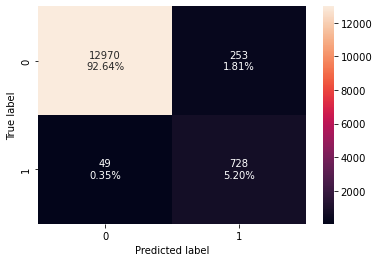

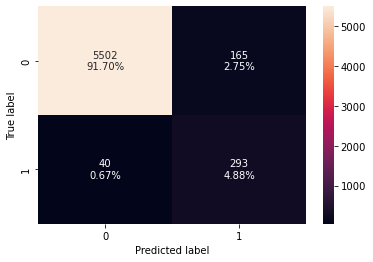

In [100]:
confusion_matrix_sklearn(gb_SMOTE_classifier_tuned,X_train,y_train)

confusion_matrix_sklearn(gb_SMOTE_classifier_tuned,X_val,y_val)

gb_classifier_pretune = get_metrics_score(gb_SMOTE_classifier_tuned, xtest=X_val, ytest=y_val)

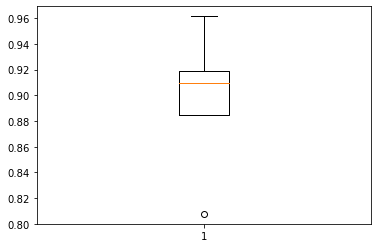

Recall: Mean = 89.97%, Standard Deviation = 3.78%
95% Confidence Interval: 82.41% to 97.53%.


In [101]:
results = cross_val_score(gb_SMOTE_classifier_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [102]:
gb_SMOTE_classifier_posttune_test = get_metrics_score(gb_SMOTE_classifier_tuned)

These metrics are performed on the Test set.

Accuracy on training set :  0.9784285714285714
Accuracy on val/test set :  0.965

Recall on training set :  0.9369369369369369
Recall on val/test set :  0.8581560283687943
Precision on training set :  0.7420998980632009
Precision on val/test set :  0.6419098143236074
F1 on training set :  0.8282138794084186
F1 on val/test set :  0.7344461305007587

Specificity on training set :  0.9808666717083869
Specificity on val/test set :  0.9713861805849936
NPV on training set :  0.9962362700668254
NPV on val/test set :  0.9913476097772009
Inverted F1 on training set :  0.9884917308132001
Inverted F1 on val/test set :  0.9812653891446312

Harmonic Mean of F1 and Inverted F1 on train set :  0.9012825925495679
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.8401022663769838


# SMOTE Model #5: XGBoost

In [103]:
# Fit SMOTE on train data(Synthetic Minority Oversampling TEchnique)
sm = SMOTE(sampling_strategy=1, k_neighbors=500, random_state=1)
    # sampling_strategy: bring the Minority class up to this ratio
    # k_neighbors: How many neighbors to look for to generate synthetic data

These metrics are performed on the Validation set.

Accuracy on training set :  0.9998571428571429
Accuracy on val/test set :  0.9795

Recall on training set :  1.0
Recall on val/test set :  0.8918918918918919
Precision on training set :  0.9974326059050064
Precision on val/test set :  0.7734375
F1 on training set :  0.9987146529562981
F1 on val/test set :  0.8284518828451882

Specificity on training set :  0.9998487483929517
Specificity on val/test set :  0.984647961884595
NPV on training set :  1.0
NPV on val/test set :  0.9935897435897436
Inverted F1 on training set :  0.9999243684767811
Inverted F1 on val/test set :  0.9890986439776656

Harmonic Mean of F1 and Inverted F1 on train set :  0.9993191446145008
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.9016757683818533


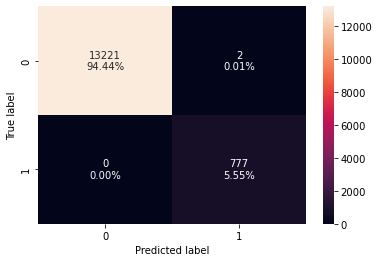

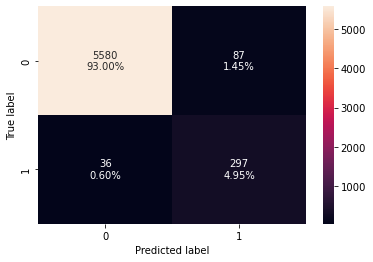

In [104]:
xgb_SMOTE_classifier= make_imb_pipeline(sm,XGBClassifier(random_state=1))
xgb_SMOTE_classifier.fit(X_train,y_train)

confusion_matrix_sklearn(xgb_SMOTE_classifier,X_train,y_train)

confusion_matrix_sklearn(xgb_SMOTE_classifier,X_val,y_val)

xgb_SMOTE_classifier_pretune = get_metrics_score(xgb_SMOTE_classifier, xtest=X_val, ytest=y_val)

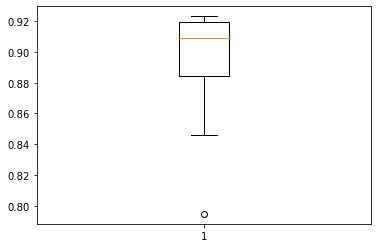

Recall: Mean = 89.07%, Standard Deviation = 3.92%
95% Confidence Interval: 81.23% to 96.91%.


In [105]:
results = cross_val_score(xgb_SMOTE_classifier,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# SMOTE XGBoost hyperparameter tuning

In [106]:
%%time
# Choose the type of classifier. 
xgb_SMOTE_classifier_tuned = make_imb_pipeline(sm,XGBClassifier(random_state=1))

# Grid of parameters to choose from
## add from
parameters = {
    "xgbclassifier__n_estimators": [80,100],
    "xgbclassifier__scale_pos_weight":[1.5],
    "xgbclassifier__subsample":[0.9],
    "xgbclassifier__learning_rate":[0.3],
    "xgbclassifier__gamma":[40], #higher gamma = better protection from overfitting
    "xgbclassifier__colsample_bytree":[0.9,1],
    "xgbclassifier__colsample_bylevel":[0.9,1],
    "xgbclassifier__colsample_bynode": [1],
}

# Type of scoring used to compare parameter combinations
acc_scorer = scoring

# Run the grid search
grid_obj = RandomizedSearchCV(xgb_SMOTE_classifier_tuned, param_distributions=parameters,
                              n_iter=8,scoring=acc_scorer,cv=5, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
xgb_SMOTE_classifier_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
xgb_SMOTE_classifier_tuned.fit(X_train, y_train)

CPU times: total: 50.3 s
Wall time: 49.2 s


Pipeline(steps=[('smote',
                 SMOTE(k_neighbors=500, random_state=1, sampling_strategy=1)),
                ('xgbclassifier',
                 XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               gamma=40, gpu_id=-1, grow_policy='depthwise',
                               importance_type=None, interaction_constraints='',
                               learning_rate=0.3, max_bin=256,
                               max_cat_to_onehot=4, max_delta_step=0,
                               max_depth=6, max_leaves=0, min_child_weight=1,
                               missing=nan, monotone_constraints='()',
                               n_estimators=80, n_jobs=0, num_parallel_tree=1,
                               predictor='auto', random_state=1, reg_alpha=0,
                               reg_lambda=1, ...))])

In [107]:
grid_obj.best_params_ #0.9382239382239382, 0.8948948948948949

{'xgbclassifier__subsample': 0.9,
 'xgbclassifier__scale_pos_weight': 1.5,
 'xgbclassifier__n_estimators': 80,
 'xgbclassifier__learning_rate': 0.3,
 'xgbclassifier__gamma': 40,
 'xgbclassifier__colsample_bytree': 1,
 'xgbclassifier__colsample_bynode': 1,
 'xgbclassifier__colsample_bylevel': 1}

    Best Params:
    {'xgbclassifier__subsample': 0.9,
     'xgbclassifier__scale_pos_weight': 1.5,
     'xgbclassifier__n_estimators': 80,
     'xgbclassifier__learning_rate': 0.3,
     'xgbclassifier__gamma': 40,
     'xgbclassifier__colsample_bytree': 1,
     'xgbclassifier__colsample_bynode': 1,
     'xgbclassifier__colsample_bylevel': 1}

These metrics are performed on the Validation set.

Accuracy on training set :  0.9657142857142857
Accuracy on val/test set :  0.9498333333333333

Recall on training set :  0.9382239382239382
Recall on val/test set :  0.8948948948948949
Precision on training set :  0.627906976744186
Precision on val/test set :  0.5283687943262412
F1 on training set :  0.7523219814241486
F1 on val/test set :  0.6644370122630993

Specificity on training set :  0.9673296528775618
Specificity on val/test set :  0.9530615846126699
NPV on training set :  0.9962613910740712
NPV on val/test set :  0.9935614422369389
Inverted F1 on training set :  0.9815823804773233
Inverted F1 on val/test set :  0.9728902098531929

Harmonic Mean of F1 and Inverted F1 on train set :  0.8517955403283024
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.7896091331815193


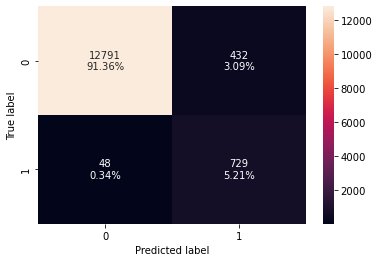

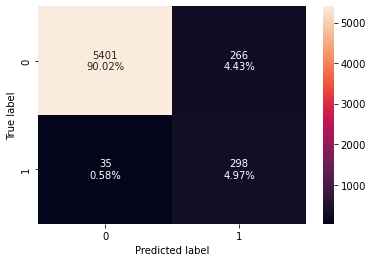

In [108]:
confusion_matrix_sklearn(xgb_SMOTE_classifier_tuned,X_train,y_train)

confusion_matrix_sklearn(xgb_SMOTE_classifier_tuned,X_val,y_val)

xgb_SMOTE_classifier_pretune = get_metrics_score(xgb_SMOTE_classifier_tuned, xtest=X_val, ytest=y_val)

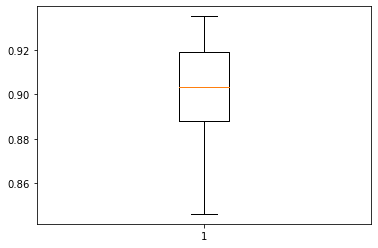

Recall: Mean = 90.1%, Standard Deviation = 2.41%
95% Confidence Interval: 85.28% to 94.92%.


In [109]:
results = cross_val_score(xgb_SMOTE_classifier_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [110]:
xgb_SMOTE_classifier_posttune_test = get_metrics_score(xgb_SMOTE_classifier_tuned)

These metrics are performed on the Test set.

Accuracy on training set :  0.9657142857142857
Accuracy on val/test set :  0.9496

Recall on training set :  0.9382239382239382
Recall on val/test set :  0.8581560283687943
Precision on training set :  0.627906976744186
Precision on val/test set :  0.5330396475770925
F1 on training set :  0.7523219814241486
F1 on val/test set :  0.6576086956521738

Specificity on training set :  0.9673296528775618
Specificity on val/test set :  0.9550657058075456
NPV on training set :  0.9962613910740712
NPV on val/test set :  0.9912010558732952
Inverted F1 on training set :  0.9815823804773233
Inverted F1 on val/test set :  0.9727979274611399

Harmonic Mean of F1 and Inverted F1 on train set :  0.8517955403283024
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.7847372148050915


## The XGBoost and GradientBoost models perform very similarly after tuning.
#### Looking at the cross_validation results of both, XGBoost has a lower recall standard deviation, but GradientBoost has a higher maximum recall.
#### XGBoost has higher mean recall and is more consistent, but GradientBoost has a higher maximum performance.
# SMOTE Model #6: Logistic Regression

In [111]:
# Fit SMOTE on train data(Synthetic Minority Oversampling TEchnique)
sm = SMOTE(sampling_strategy=1, k_neighbors=12, random_state=1)
    # sampling_strategy: bring the Minority class up to this ratio
    # k_neighbors: How many neighbors to look for to generate synthetic data

These metrics are performed on the Validation set.

Accuracy on training set :  0.8791428571428571
Accuracy on val/test set :  0.8688333333333333

Recall on training set :  0.8545688545688546
Recall on val/test set :  0.8498498498498499
Precision on training set :  0.29603209986625056
Precision on val/test set :  0.2774509803921569
F1 on training set :  0.4397350993377484
F1 on val/test set :  0.418329637841833

Specificity on training set :  0.8805868562353475
Specificity on val/test set :  0.8699488265396154
NPV on training set :  0.990388704601514
NPV on val/test set :  0.9899598393574297
Inverted F1 on training set :  0.9322658126501201
Inverted F1 on val/test set :  0.9260824645440031

Harmonic Mean of F1 and Inverted F1 on train set :  0.59759435457068
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.5763229017603442


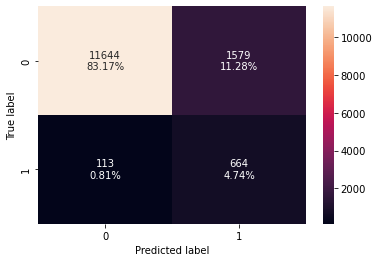

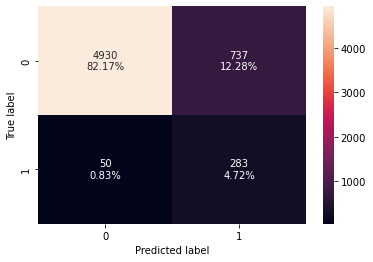

In [112]:
Log_SMOTE = make_imb_pipeline(sm,LogisticRegression(random_state=1,max_iter=5000,
    penalty='l2',solver='sag'))
    #only increase max_iter if warning is thrown)
    #Check shift-tab for optimal Penalty and Solver
Log_SMOTE.fit(X_train, y_train)

confusion_matrix_sklearn(Log_SMOTE,X_train,y_train)

confusion_matrix_sklearn(Log_SMOTE,X_val,y_val)

Log_pretune = get_metrics_score(Log_SMOTE, xtest=X_val, ytest=y_val)

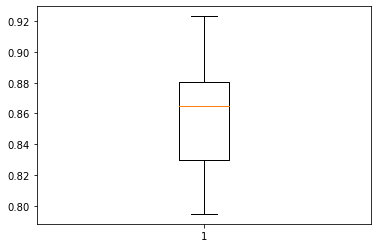

Recall: Mean = 85.72%, Standard Deviation = 3.71%
95% Confidence Interval: 78.31% to 93.14%.


In [113]:
results = cross_val_score(Log_SMOTE,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [114]:
Log_SMOTE_test = get_metrics_score(Log_SMOTE)

These metrics are performed on the Test set.

Accuracy on training set :  0.8791428571428571
Accuracy on val/test set :  0.8786

Recall on training set :  0.8545688545688546
Recall on val/test set :  0.8085106382978723
Precision on training set :  0.29603209986625056
Precision on val/test set :  0.2919334186939821
F1 on training set :  0.4397350993377484
F1 on val/test set :  0.42897460018814676

Specificity on training set :  0.8805868562353475
Specificity on val/test set :  0.8827893175074184
NPV on training set :  0.990388704601514
NPV on val/test set :  0.9872007584735719
Inverted F1 on training set :  0.9322658126501201
Inverted F1 on val/test set :  0.9320801163701465

Harmonic Mean of F1 and Inverted F1 on train set :  0.59759435457068
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.5875424263240191


# All SMOTE model performances:

In [115]:
list_of_test_results=[
    dtreeSMOTE_posttune_test,
    rf_classifier_SMOTE_posttune_test,
    ab_classifier_SMOTE_posttune_test,
    ab_classifier_rf_SMOTE_posttune_test,
    gb_SMOTE_classifier_posttune_test,
    xgb_SMOTE_classifier_posttune_test,
    Log_SMOTE_test
]

list_=[]
for entry in list_of_test_results:
    list_.append([entry[2],entry[3]])
    
Metrics_SMOTE=pd.DataFrame(list_,index=['dtree SMOTE','rf SMOTE','ab SMOTE', 'ab+rf SMOTE',
                                  'gb SMOTE','xgb SMOTE','log SMOTE'],
                     columns=['train_recall','test_recall']).sort_values('test_recall',ascending=False)

In [116]:
Metrics_full=pd.concat([Metrics,Metrics_SMOTE])
Metrics_full.sort_values('test_recall',ascending=False,inplace=True)
Metrics_full

,train_recall,test_recall
dtree,0.909910,0.893617
gb SMOTE,0.936937,0.858156
xgb SMOTE,0.938224,0.858156
ab+rf SMOTE,0.998713,0.854610
rf SMOTE,0.911197,0.840426
ab SMOTE,0.881596,0.836879
dtree SMOTE,0.909910,0.819149
rf,0.889318,0.815603
log,0.866152,0.812057
log SMOTE,0.854569,0.808511


### While on the surface our tuned Dtree seems to be the best model, investigating the metrics further reveals an accuracy of 55% and a very low specificity. The Dtree model gains its high recall from assigning around half of the entire dataset a 'failed' label, which makes it very bad in practice.

### Optimizing for successful predictions as well as saving money on unnecessary machine investigations makes a better overall model.

---
---
---
# Undersampling models

In [117]:
# fit random under sampler on the train data
rus = RandomUnderSampler(random_state=1, sampling_strategy = 1)
    # sampling_strategy: bring the Minority class up to this ratio (by bringing the Majority down with undersampling)

# Undersampled Model #1: Decision Tree

These metrics are performed on the Validation set.

Accuracy on training set :  0.8579285714285714
Accuracy on val/test set :  0.8315

Recall on training set :  1.0
Recall on val/test set :  0.8408408408408409
Precision on training set :  0.2809110629067245
Precision on val/test set :  0.22617124394184168
F1 on training set :  0.4386113463166808
F1 on val/test set :  0.35646085295989816

Specificity on training set :  0.8495802767904409
Specificity on val/test set :  0.8309511205223222
NPV on training set :  1.0
NPV on val/test set :  0.9888702225955481
Inverted F1 on training set :  0.9186735903831215
Inverted F1 on val/test set :  0.903058778406367

Harmonic Mean of F1 and Inverted F1 on train set :  0.5937451295720676
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.5111553554341512


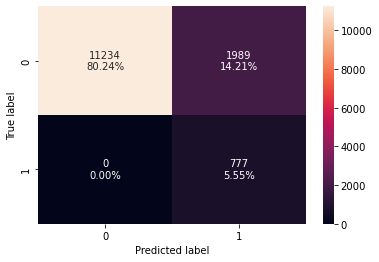

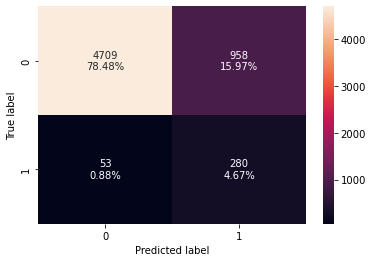

In [118]:
dtree_un = make_imb_pipeline(rus,DecisionTreeClassifier(random_state=1))
dtree_un.fit(X_train,y_train)

confusion_matrix_sklearn(dtree_un,X_train,y_train)

confusion_matrix_sklearn(dtree_un,X_val,y_val)

dtree_rus_pretune = get_metrics_score(dtree_un, xtest=X_val, ytest=y_val)

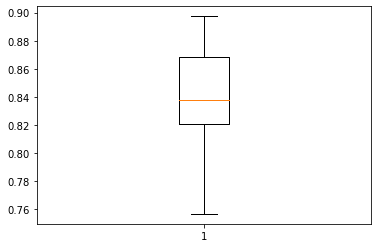

Recall: Mean = 83.79%, Standard Deviation = 4.05%
95% Confidence Interval: 75.7% to 91.88%.


In [119]:
results = cross_val_score(dtree_un,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# Undersampled dtree hyperparameter tuning

In [120]:
%%time
# Choose the type of classifier. We're using the decision tree since it's what we created at the start.
dt_rus_estimator = make_imb_pipeline(rus,DecisionTreeClassifier(random_state=1))

# Grid of parameters to choose from (these are what we can adjust to look more closely at certain hyperparameter ranges)
    # make sure you don't get too narrow in range with these, the more you have the better the results.
## add from article
parameters = {'decisiontreeclassifier__max_depth': [None]+list(np.arange(2,11,2)), 
              'decisiontreeclassifier__min_samples_leaf': [1,5,10,20],
              'decisiontreeclassifier__max_leaf_nodes' : [None]+[2,5,10],
              'decisiontreeclassifier__min_impurity_decrease': [0, 0.00001, 0.001, 0.1],
              'decisiontreeclassifier__min_samples_split' : np.arange(2,11,2)
             }

# Type of scoring used to compare parameter combinations
acc_scorer = scoring #we can insert any scoring method we need

# Run the grid search
grid_obj = GridSearchCV(dt_rus_estimator, parameters, scoring=acc_scorer,cv=5,n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
dt_rus_estimator = grid_obj.best_estimator_

# Fit the best algorithm to the data. 
dt_rus_estimator.fit(X_train, y_train)

CPU times: total: 10.1 s
Wall time: 23.5 s


Pipeline(steps=[('randomundersampler',
                 RandomUnderSampler(random_state=1, sampling_strategy=1)),
                ('decisiontreeclassifier',
                 DecisionTreeClassifier(min_impurity_decrease=0.001,
                                        random_state=1))])

These metrics are performed on the Validation set.

Accuracy on training set :  0.9032857142857142
Accuracy on val/test set :  0.8873333333333333

Recall on training set :  0.9433719433719434
Recall on val/test set :  0.8438438438438438
Precision on training set :  0.3587860988742046
Precision on val/test set :  0.3104972375690608
F1 on training set :  0.5198581560283688
F1 on val/test set :  0.4539579967689823

Specificity on training set :  0.9009301973833472
Specificity on val/test set :  0.8898888300688195
NPV on training set :  0.9963201471941122
NPV on val/test set :  0.9897939156035329
Inverted F1 on training set :  0.9462271644162034
Inverted F1 on val/test set :  0.9371863965805612

Harmonic Mean of F1 and Inverted F1 on train set :  0.6710440409132475
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.6116450042493243


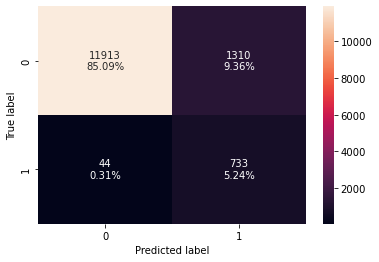

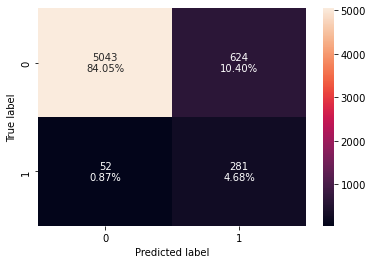

In [121]:
confusion_matrix_sklearn(dt_rus_estimator,X_train,y_train)

confusion_matrix_sklearn(dt_rus_estimator,X_val,y_val)

dtree_rus_pretune = get_metrics_score(dt_rus_estimator, xtest=X_val, ytest=y_val)

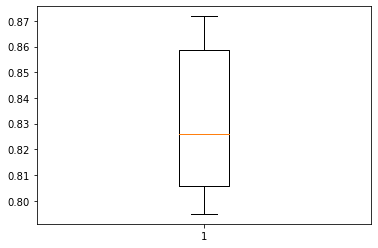

Recall: Mean = 83.14%, Standard Deviation = 2.95%
95% Confidence Interval: 77.23% to 89.05%.


In [122]:
results = cross_val_score(dt_rus_estimator,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [123]:
dtree_rus_posttune_test = get_metrics_score(dt_rus_estimator)

These metrics are performed on the Test set.

Accuracy on training set :  0.9032857142857142
Accuracy on val/test set :  0.8886

Recall on training set :  0.9433719433719434
Recall on val/test set :  0.8120567375886525
Precision on training set :  0.3587860988742046
Precision on val/test set :  0.31241473396998637
F1 on training set :  0.5198581560283688
F1 on val/test set :  0.4512315270935961

Specificity on training set :  0.9009301973833472
Specificity on val/test set :  0.8931750741839762
NPV on training set :  0.9963201471941122
NPV on val/test set :  0.9875790953831732
Inverted F1 on training set :  0.9462271644162034
Inverted F1 on val/test set :  0.9380077907623817

Harmonic Mean of F1 and Inverted F1 on train set :  0.6710440409132475
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.6093387689381233


# Undersampled Model #2: Random Forest

These metrics are performed on the Validation set.

Accuracy on training set :  0.9495
Accuracy on val/test set :  0.935

Recall on training set :  1.0
Recall on val/test set :  0.8828828828828829
Precision on training set :  0.5235849056603774
Precision on val/test set :  0.4558139534883721
F1 on training set :  0.6873065015479877
F1 on val/test set :  0.6012269938650306

Specificity on training set :  0.9465325569084172
Specificity on val/test set :  0.938062466913711
NPV on training set :  1.0
NPV on val/test set :  0.9927170868347339
Inverted F1 on training set :  0.9725319553984227
Inverted F1 on val/test set :  0.964616222101252

Harmonic Mean of F1 and Inverted F1 on train set :  0.8054127594298707
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.7407552755394977


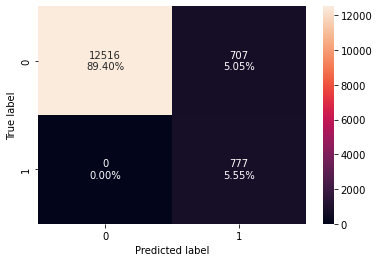

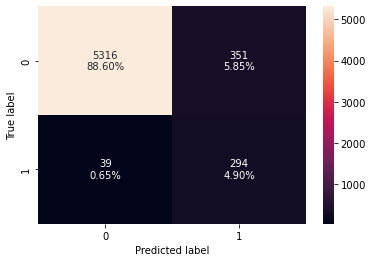

In [124]:
rf_rus_classifier=make_imb_pipeline(rus,RandomForestClassifier(random_state=1))
rf_rus_classifier.fit(X_train,y_train)

confusion_matrix_sklearn(rf_rus_classifier,X_train,y_train)

confusion_matrix_sklearn(rf_rus_classifier,X_val,y_val)

rf_classifier_pretune = get_metrics_score(rf_rus_classifier, xtest=X_val, ytest=y_val)

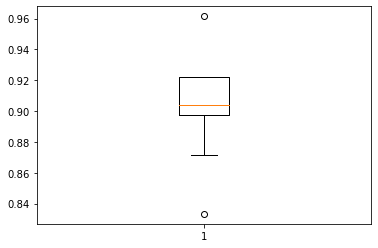

Recall: Mean = 90.35%, Standard Deviation = 3.24%
95% Confidence Interval: 83.88% to 96.83%.


In [125]:
results = cross_val_score(rf_rus_classifier,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# Undersampled RF hyperparameter tuning

In [126]:
%%time
# Choose the type of classifier. 
rf_rus_classifier_tuned = make_imb_pipeline(rus,RandomForestClassifier(random_state=1))

# Grid of parameters to choose from
## add from article
parameters = {
    "randomforestclassifier__n_estimators": [50,100,150],
    "randomforestclassifier__max_depth" : [None],
    "randomforestclassifier__min_samples_leaf": [1],
    "randomforestclassifier__max_features": ['sqrt',0.3,0.7],
    "randomforestclassifier__max_samples": [None,0.7,0.3],
    "randomforestclassifier__min_impurity_decrease": [0.001]
}

# Type of scoring used to compare parameter combinations
acc_scorer = scoring

# Run the grid search
grid_obj = RandomizedSearchCV(rf_rus_classifier_tuned, param_distributions=parameters,
                              n_iter=27,scoring=acc_scorer,cv=5, n_jobs=7)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
rf_rus_classifier_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
rf_rus_classifier_tuned.fit(X_train, y_train)

CPU times: total: 906 ms
Wall time: 13.6 s


Pipeline(steps=[('randomundersampler',
                 RandomUnderSampler(random_state=1, sampling_strategy=1)),
                ('randomforestclassifier',
                 RandomForestClassifier(max_samples=0.3,
                                        min_impurity_decrease=0.001,
                                        n_estimators=150, random_state=1))])

In [127]:
grid_obj.best_params_ #0.9266409266409267, 0.8738738738738738

{'randomforestclassifier__n_estimators': 150,
 'randomforestclassifier__min_samples_leaf': 1,
 'randomforestclassifier__min_impurity_decrease': 0.001,
 'randomforestclassifier__max_samples': 0.3,
 'randomforestclassifier__max_features': 'sqrt',
 'randomforestclassifier__max_depth': None}

These metrics are performed on the Validation set.

Accuracy on training set :  0.9228571428571428
Accuracy on val/test set :  0.9113333333333333

Recall on training set :  0.9266409266409267
Recall on val/test set :  0.8738738738738738
Precision on training set :  0.41308089500860584
Precision on val/test set :  0.3725992317541613
F1 on training set :  0.5714285714285714
F1 on val/test set :  0.5224416517055656

Specificity on training set :  0.9226348029947818
Specificity on val/test set :  0.9135344979707076
NPV on training set :  0.9953495961491393
NPV on val/test set :  0.9919524813182602
Inverted F1 on training set :  0.957613814756672
Inverted F1 on val/test set :  0.9511298916038948

Harmonic Mean of F1 and Inverted F1 on train set :  0.7157524200645351
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.6744292447994428


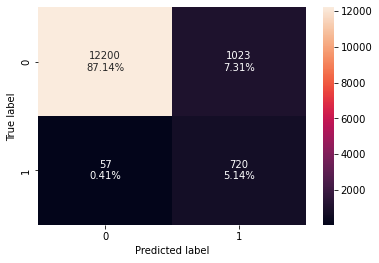

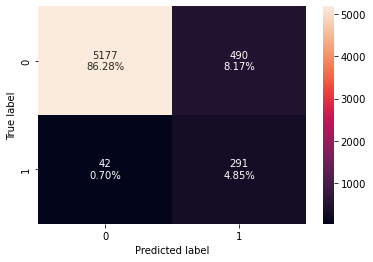

In [128]:
confusion_matrix_sklearn(rf_rus_classifier_tuned,X_train,y_train)

confusion_matrix_sklearn(rf_rus_classifier_tuned,X_val,y_val)

rf_classifier_pretune = get_metrics_score(rf_rus_classifier_tuned, xtest=X_val, ytest=y_val)

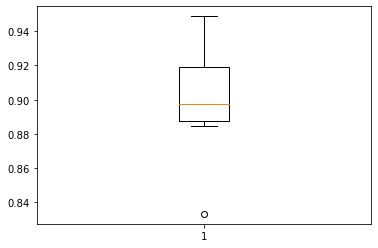

Recall: Mean = 90.1%, Standard Deviation = 3.02%
95% Confidence Interval: 84.06% to 96.13%.


In [129]:
results = cross_val_score(rf_rus_classifier_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [130]:
rf_rus_classifier_posttune_test = get_metrics_score(rf_rus_classifier_tuned)

These metrics are performed on the Test set.

Accuracy on training set :  0.9228571428571428
Accuracy on val/test set :  0.919

Recall on training set :  0.9266409266409267
Recall on val/test set :  0.8617021276595744
Precision on training set :  0.41308089500860584
Precision on val/test set :  0.39901477832512317
F1 on training set :  0.5714285714285714
F1 on val/test set :  0.5454545454545454

Specificity on training set :  0.9226348029947818
Specificity on val/test set :  0.9224247562526494
NPV on training set :  0.9953495961491393
NPV on val/test set :  0.9911181963106354
Inverted F1 on training set :  0.957613814756672
Inverted F1 on val/test set :  0.9555384784279284

Harmonic Mean of F1 and Inverted F1 on train set :  0.7157524200645351
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.69447732017713


# Undersampled Model #3: Adaboost w/Random Forest

These metrics are performed on the Validation set.

Accuracy on training set :  0.9762857142857143
Accuracy on val/test set :  0.9675

Recall on training set :  0.9948519948519948
Recall on val/test set :  0.8828828828828829
Precision on training set :  0.7020890099909174
Precision on val/test set :  0.6533333333333333
F1 on training set :  0.8232161874334399
F1 on val/test set :  0.7509578544061303

Specificity on training set :  0.9751947364440747
Specificity on val/test set :  0.9724722075172049
NPV on training set :  0.9996898984417397
NPV on val/test set :  0.9929729729729729
Inverted F1 on training set :  0.9872904065538626
Inverted F1 on val/test set :  0.9826156726397433

Harmonic Mean of F1 and Inverted F1 on train set :  0.8978188171996038
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.8513085204857905


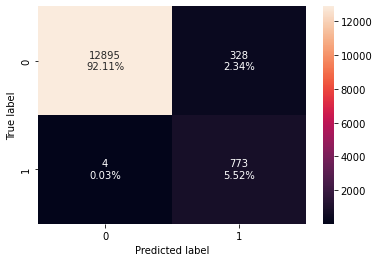

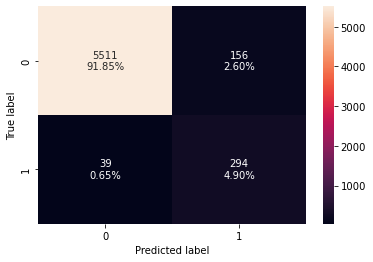

In [131]:
ab_rus_classifier=make_imb_pipeline(rus,AdaBoostClassifier(random_state=1, base_estimator=RandomForestClassifier(
            random_state=1,
            n_estimators= 150,
            min_samples_leaf= 1,
            min_impurity_decrease= 0.001,
            max_samples= 0.3,
            max_features= 'sqrt',
            max_depth= None
)))
ab_rus_classifier.fit(X_train,y_train)

confusion_matrix_sklearn(ab_rus_classifier,X_train,y_train)

confusion_matrix_sklearn(ab_rus_classifier,X_val,y_val)

ab_classifier_pretune = get_metrics_score(ab_rus_classifier, xtest=X_val, ytest=y_val)

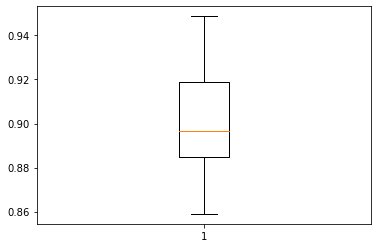

Recall: Mean = 89.84%, Standard Deviation = 2.7%
95% Confidence Interval: 84.43% to 95.24%.


In [132]:
results = cross_val_score(ab_rus_classifier,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# Undersampled Ada hyperparameter tuning

In [133]:
%%time
# Choose the type of classifier. 
ab_rus_classifier_tuned = make_imb_pipeline(rus,AdaBoostClassifier(random_state=1, base_estimator=RandomForestClassifier(
            random_state=1,
            n_estimators= 150,
            min_samples_leaf= 1,
            min_impurity_decrease= 0.001,
            max_samples= 0.3,
            max_features= 'sqrt',
            max_depth= None
)))

# Grid of parameters to choose from
## add from article
parameters = {
    "adaboostclassifier__n_estimators": [50,80],
    "adaboostclassifier__learning_rate": [0.5,0.7,1]
}

# Type of scoring used to compare parameter combinations
acc_scorer = scoring

# Run the grid search
grid_obj = GridSearchCV(ab_rus_classifier_tuned, parameters, scoring=acc_scorer,cv=5, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
ab_rus_classifier_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
ab_rus_classifier_tuned.fit(X_train, y_train)

CPU times: total: 38.7 s
Wall time: 1min 30s


Pipeline(steps=[('randomundersampler',
                 RandomUnderSampler(random_state=1, sampling_strategy=1)),
                ('adaboostclassifier',
                 AdaBoostClassifier(base_estimator=RandomForestClassifier(max_samples=0.3,
                                                                          min_impurity_decrease=0.001,
                                                                          n_estimators=150,
                                                                          random_state=1),
                                    learning_rate=0.7, n_estimators=80,
                                    random_state=1))])

In [134]:
grid_obj.best_params_

{'adaboostclassifier__learning_rate': 0.7,
 'adaboostclassifier__n_estimators': 80}

    Best Params:
    {'adaboostclassifier__learning_rate': 0.7,
     'adaboostclassifier__n_estimators': 80}

These metrics are performed on the Validation set.

Accuracy on training set :  0.9767857142857143
Accuracy on val/test set :  0.9665

Recall on training set :  0.9961389961389961
Recall on val/test set :  0.8828828828828829
Precision on training set :  0.7062043795620438
Precision on val/test set :  0.6447368421052632
F1 on training set :  0.8264815803523758
F1 on val/test set :  0.7452471482889734

Specificity on training set :  0.9756484912652197
Specificity on val/test set :  0.9714134462678666
NPV on training set :  0.9997675139491631
NPV on val/test set :  0.9929653679653679
Inverted F1 on training set :  0.9875607608986873
Inverted F1 on val/test set :  0.982071180090982

Harmonic Mean of F1 and Inverted F1 on train set :  0.899869600396036
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.8474242811584403


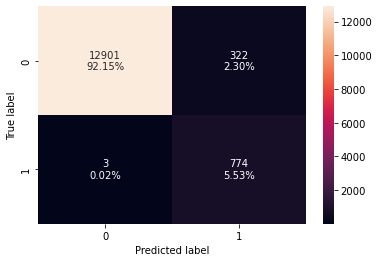

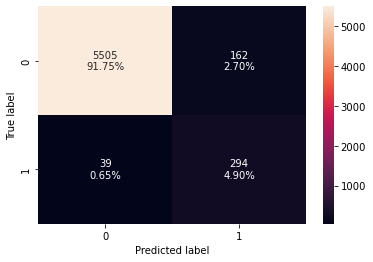

In [135]:
confusion_matrix_sklearn(ab_rus_classifier_tuned,X_train,y_train)

confusion_matrix_sklearn(ab_rus_classifier_tuned,X_val,y_val)

ab_classifier_pretune = get_metrics_score(ab_rus_classifier_tuned, xtest=X_val, ytest=y_val)

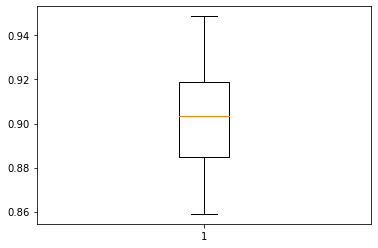

Recall: Mean = 90.22%, Standard Deviation = 2.69%
95% Confidence Interval: 84.85% to 95.6%.


In [136]:
results = cross_val_score(ab_rus_classifier_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [137]:
ab_rus_classifier_posttune_test = get_metrics_score(ab_rus_classifier_tuned)

These metrics are performed on the Test set.

Accuracy on training set :  0.9767857142857143
Accuracy on val/test set :  0.967

Recall on training set :  0.9961389961389961
Recall on val/test set :  0.8723404255319149
Precision on training set :  0.7062043795620438
Precision on val/test set :  0.656
F1 on training set :  0.8264815803523758
F1 on val/test set :  0.7488584474885844

Specificity on training set :  0.9756484912652197
Specificity on val/test set :  0.9726579058923273
NPV on training set :  0.9997675139491631
NPV on val/test set :  0.9922162162162163
Inverted F1 on training set :  0.9875607608986873
Inverted F1 on val/test set :  0.9823397195761533

Harmonic Mean of F1 and Inverted F1 on train set :  0.899869600396036
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.8498546397555893


# Undersampled Model #4: Gradientboost

These metrics are performed on the Validation set.

Accuracy on training set :  0.9372142857142857
Accuracy on val/test set :  0.926

Recall on training set :  0.9498069498069498
Recall on val/test set :  0.8828828828828829
Precision on training set :  0.467680608365019
Precision on val/test set :  0.4206008583690987
F1 on training set :  0.6267515923566879
F1 on val/test set :  0.5697674418604651

Specificity on training set :  0.9364743250397035
Specificity on val/test set :  0.9285336156696665
NPV on training set :  0.9968604089518596
NPV on val/test set :  0.9926428975664969
Inverted F1 on training set :  0.9657243127315266
Inverted F1 on val/test set :  0.9595185995623633

Harmonic Mean of F1 and Inverted F1 on train set :  0.7601612669279585
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.7149773725542393


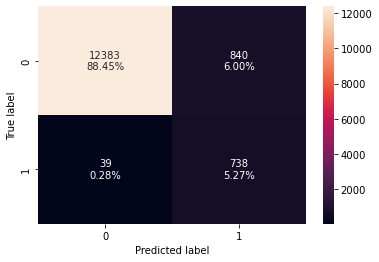

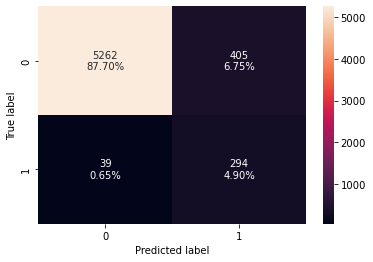

In [138]:
gb_rus_classifier=make_imb_pipeline(rus,GradientBoostingClassifier(random_state=1))
gb_rus_classifier.fit(X_train,y_train)

confusion_matrix_sklearn(gb_rus_classifier,X_train,y_train)

confusion_matrix_sklearn(gb_rus_classifier,X_val,y_val)

gb_classifier_pretune = get_metrics_score(gb_rus_classifier, xtest=X_val, ytest=y_val)

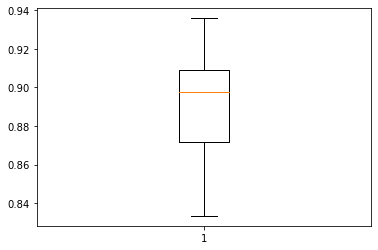

Recall: Mean = 89.07%, Standard Deviation = 2.97%
95% Confidence Interval: 83.13% to 95.0%.


In [139]:
results = cross_val_score(gb_rus_classifier,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# Undersampled Gradientboost hyperparameter tuning

In [140]:
%%time
# Choose the type of classifier. 
gb_rus_classifier_tuned = make_imb_pipeline(rus,GradientBoostingClassifier(random_state=1))

# Grid of parameters to choose from
## add from article
parameters = {
    "gradientboostingclassifier__n_estimators": [100,150,200,250],
    "gradientboostingclassifier__subsample":[1,0.8,0.9,1.0],
    "gradientboostingclassifier__max_features":[None,0.7,0.9],
    "gradientboostingclassifier__learning_rate" : [0.1,0.5,0.9],
    "gradientboostingclassifier__min_impurity_decrease" : [0.000000000001,0.00000001,0.0001]
}

# Type of scoring used to compare parameter combinations
acc_scorer = scoring

# Run the grid search
grid_obj = GridSearchCV(gb_rus_classifier_tuned, parameters, scoring=acc_scorer,cv=5, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
gb_rus_classifier_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
gb_rus_classifier_tuned.fit(X_train, y_train)

CPU times: total: 7.33 s
Wall time: 3min 40s


Pipeline(steps=[('randomundersampler',
                 RandomUnderSampler(random_state=1, sampling_strategy=1)),
                ('gradientboostingclassifier',
                 GradientBoostingClassifier(learning_rate=0.5, max_features=0.7,
                                            min_impurity_decrease=0.0001,
                                            n_estimators=150, random_state=1,
                                            subsample=0.9))])

These metrics are performed on the Validation set.

Accuracy on training set :  0.9365714285714286
Accuracy on val/test set :  0.9231666666666667

Recall on training set :  1.0
Recall on val/test set :  0.8858858858858859
Precision on training set :  0.4666666666666667
Precision on val/test set :  0.41086350974930363
F1 on training set :  0.6363636363636364
F1 on val/test set :  0.5613701236917221

Specificity on training set :  0.9328442864705437
Specificity on val/test set :  0.9253573319216517
NPV on training set :  1.0
NPV on val/test set :  0.9928057553956835
Inverted F1 on training set :  0.9652554973002583
Inverted F1 on val/test set :  0.957895698237282

Harmonic Mean of F1 and Inverted F1 on train set :  0.7670406595066137
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.7078866895333343


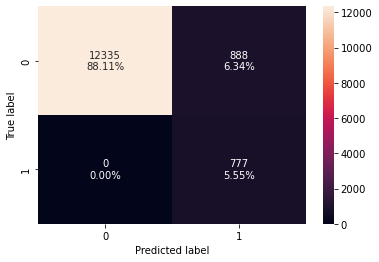

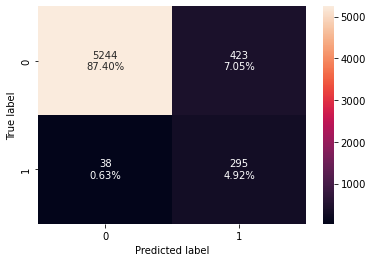

In [141]:
confusion_matrix_sklearn(gb_rus_classifier_tuned,X_train,y_train)

confusion_matrix_sklearn(gb_rus_classifier_tuned,X_val,y_val)

ab_classifier_pretune = get_metrics_score(gb_rus_classifier_tuned, xtest=X_val, ytest=y_val)

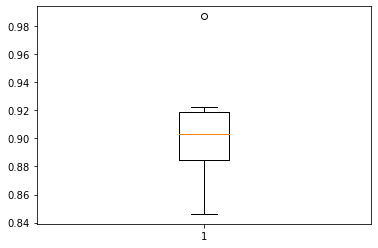

Recall: Mean = 90.35%, Standard Deviation = 3.58%
95% Confidence Interval: 83.19% to 97.51%.


In [142]:
results = cross_val_score(gb_rus_classifier_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [143]:
gb_rus_classifier_posttune_test = get_metrics_score(gb_rus_classifier_tuned)

These metrics are performed on the Test set.

Accuracy on training set :  0.9365714285714286
Accuracy on val/test set :  0.9232

Recall on training set :  1.0
Recall on val/test set :  0.8687943262411347
Precision on training set :  0.4666666666666667
Precision on val/test set :  0.41385135135135137
F1 on training set :  0.6363636363636364
F1 on val/test set :  0.5606407322654462

Specificity on training set :  0.9328442864705437
Specificity on val/test set :  0.9264518863925392
NPV on training set :  1.0
NPV on val/test set :  0.9916061705989111
Inverted F1 on training set :  0.9652554973002583
Inverted F1 on val/test set :  0.957922419460881

Harmonic Mean of F1 and Inverted F1 on train set :  0.7670406595066137
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.7073137868379181


# Undersampled Model #5: XGBoost

These metrics are performed on the Validation set.

Accuracy on training set :  0.9582142857142857
Accuracy on val/test set :  0.948

Recall on training set :  1.0
Recall on val/test set :  0.8918918918918919
Precision on training set :  0.5704845814977973
Precision on val/test set :  0.518324607329843
F1 on training set :  0.7265077138849929
F1 on val/test set :  0.6556291390728478

Specificity on training set :  0.955758904938365
Specificity on val/test set :  0.9512969825304394
NPV on training set :  1.0
NPV on val/test set :  0.9933665008291874
Inverted F1 on training set :  0.9773790650013534
Inverted F1 on val/test set :  0.9718766901027582

Harmonic Mean of F1 and Inverted F1 on train set :  0.8334748985813322
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.783027214028231


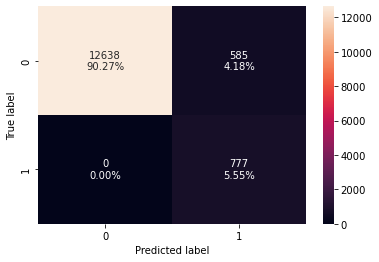

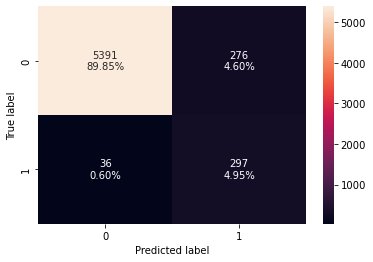

In [144]:
xgb_rus_classifier=make_imb_pipeline(rus,XGBClassifier(random_state=1))
xgb_rus_classifier.fit(X_train,y_train)

confusion_matrix_sklearn(xgb_rus_classifier,X_train,y_train)

confusion_matrix_sklearn(xgb_rus_classifier,X_val,y_val)

xgb_classifier_pretune = get_metrics_score(xgb_rus_classifier, xtest=X_val, ytest=y_val)

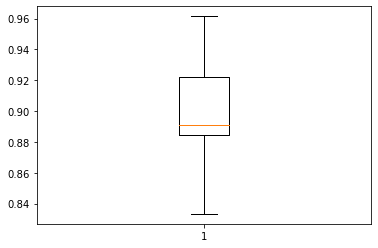

Recall: Mean = 89.97%, Standard Deviation = 3.46%
95% Confidence Interval: 83.06% to 96.88%.


In [145]:
results = cross_val_score(xgb_rus_classifier,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# Undersampled XGB hyperparameter tuning

In [146]:
%%time
# Choose the type of classifier. 
xgb_rus_classifier_tuned = make_imb_pipeline(rus,XGBClassifier(random_state=1))

# Grid of parameters to choose from
## add from
parameters = {
    "xgbclassifier__n_estimators": [70,80,90],
    "xgbclassifier__scale_pos_weight":[2,2.5,3],
    "xgbclassifier__subsample":[0.6,0.7,0.8],
    "xgbclassifier__learning_rate":[0.0001,0.001,0.01,0.1,0.2],
    "xgbclassifier__gamma":[10], #higher gamma = better protection from overfitting
    "xgbclassifier__colsample_bytree":[0.3,0.4,0.5,0.6,0.7,0.9],
    "xgbclassifier__colsample_bylevel":[0.3,0.4,0.5,0.6,0.7,0.9],
    "xgbclassifier__colsample_bynode": [0.8,0.9],
}

# Type of scoring used to compare parameter combinations
acc_scorer = scoring

# Run the grid search
grid_obj = RandomizedSearchCV(xgb_rus_classifier_tuned,param_distributions=parameters,
                              n_iter=100,scoring=acc_scorer,cv=5, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
xgb_rus_classifier_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
xgb_rus_classifier_tuned.fit(X_train, y_train)

CPU times: total: 3.69 s
Wall time: 9.62 s


Pipeline(steps=[('randomundersampler',
                 RandomUnderSampler(random_state=1, sampling_strategy=1)),
                ('xgbclassifier',
                 XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
                               colsample_bylevel=0.3, colsample_bynode=0.8,
                               colsample_bytree=0.5, early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               gamma=10, gpu_id=-1, grow_policy='depthwise',
                               importance_type=None, interaction_constraints='',
                               learning_rate=0.0001, max_bin=256,
                               max_cat_to_onehot=4, max_delta_step=0,
                               max_depth=6, max_leaves=0, min_child_weight=1,
                               missing=nan, monotone_constraints='()',
                               n_estimators=90, n_jobs=0, num_parallel_tree=1,
                               predictor='auto', random_state=1, reg_alpha=0,
                               reg_lambda=1, ...))])

In [147]:
grid_obj.best_params_

{'xgbclassifier__subsample': 0.7,
 'xgbclassifier__scale_pos_weight': 3,
 'xgbclassifier__n_estimators': 90,
 'xgbclassifier__learning_rate': 0.0001,
 'xgbclassifier__gamma': 10,
 'xgbclassifier__colsample_bytree': 0.5,
 'xgbclassifier__colsample_bynode': 0.8,
 'xgbclassifier__colsample_bylevel': 0.3}

    Best params:
    {'xgbclassifier__subsample': 0.7,
     'xgbclassifier__scale_pos_weight': 3,
     'xgbclassifier__n_estimators': 90,
     'xgbclassifier__learning_rate': 0.0001,
     'xgbclassifier__gamma': 10,
     'xgbclassifier__colsample_bytree': 0.5,
     'xgbclassifier__colsample_bynode': 0.8,
     'xgbclassifier__colsample_bylevel': 0.3}

These metrics are performed on the Validation set.

Accuracy on training set :  0.7528571428571429
Accuracy on val/test set :  0.7423333333333333

Recall on training set :  0.9510939510939511
Recall on val/test set :  0.918918918918919
Precision on training set :  0.17760153809180484
Precision on val/test set :  0.16767123287671232
F1 on training set :  0.29931146213041715
F1 on val/test set :  0.283595922150139

Specificity on training set :  0.7412085003403162
Specificity on val/test set :  0.7319569437091936
NPV on training set :  0.996137818884033
NPV on val/test set :  0.9935329341317365
Inverted F1 on training set :  0.8499696470384182
Inverted F1 on val/test set :  0.8429181060760008

Harmonic Mean of F1 and Inverted F1 on train set :  0.4427213773756897
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.4244033036429883


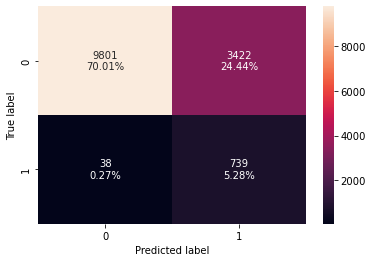

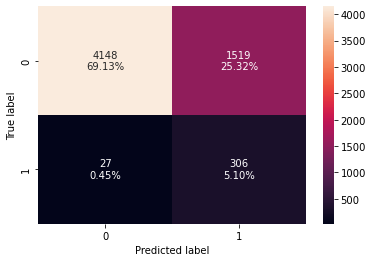

In [148]:
confusion_matrix_sklearn(xgb_rus_classifier_tuned,X_train,y_train)

confusion_matrix_sklearn(xgb_rus_classifier_tuned,X_val,y_val)

xgb_classifier_pretune = get_metrics_score(xgb_rus_classifier_tuned, xtest=X_val, ytest=y_val)

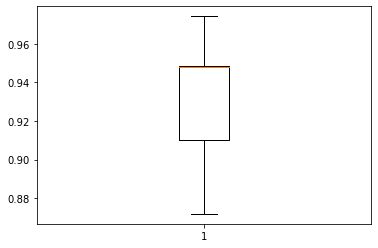

Recall: Mean = 93.32%, Standard Deviation = 2.96%
95% Confidence Interval: 87.4% to 99.23%.


In [149]:
results = cross_val_score(xgb_rus_classifier_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [150]:
xgb_rus_classifier_posttune_test=get_metrics_score(xgb_rus_classifier_tuned)

These metrics are performed on the Test set.

Accuracy on training set :  0.7528571428571429
Accuracy on val/test set :  0.755

Recall on training set :  0.9510939510939511
Recall on val/test set :  0.9042553191489362
Precision on training set :  0.17760153809180484
Precision on val/test set :  0.17549896765313144
F1 on training set :  0.29931146213041715
F1 on val/test set :  0.2939481268011527

Specificity on training set :  0.7412085003403162
Specificity on val/test set :  0.7460788469690547
NPV on training set :  0.996137818884033
NPV on val/test set :  0.9923879334649
Inverted F1 on training set :  0.8499696470384182
Inverted F1 on val/test set :  0.8517846339987901

Harmonic Mean of F1 and Inverted F1 on train set :  0.4427213773756897
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.43706613997340155


# These parameters are surprisingly great for XGBoost. Let's try them on the SMOTE XGB Model.

In [151]:
# Fit SMOTE on train data(Synthetic Minority Oversampling TEchnique)
sm = SMOTE(sampling_strategy=1, k_neighbors=3, random_state=1)
    # sampling_strategy: bring the Minority class up to this ratio
    # k_neighbors: How many neighbors to look for to generate synthetic data

In [172]:
xgb_final=make_imb_pipeline(sm,XGBClassifier(random_state=1,
                                        subsample= 0.7,
                                        scale_pos_weight= 3,
                                        n_estimators= 90,
                                        learning_rate= 0.0001,
                                        gamma= 10,
                                        colsample_bytree= 0.5,
                                        colsample_bynode= 0.8,
                                        colsample_bylevel= 0.3))
xgb_final.fit(X_train,y_train)
xgb_final_metrics=get_metrics_score(xgb_final)

These metrics are performed on the Test set.

Accuracy on training set :  0.8490714285714286
Accuracy on val/test set :  0.8452

Recall on training set :  0.9446589446589446
Recall on val/test set :  0.8936170212765957
Precision on training set :  0.26176890156918686
Precision on val/test set :  0.25301204819277107
F1 on training set :  0.40994135716280367
F1 on val/test set :  0.39436619718309857

Specificity on training set :  0.8434545867049837
Specificity on val/test set :  0.8423060618906316
NPV on training set :  0.9961593426223652
NPV on val/test set :  0.9925074925074925
Inverted F1 on training set :  0.9134690200253901
Inverted F1 on val/test set :  0.9112588855767026

Harmonic Mean of F1 and Inverted F1 on train set :  0.5659147551661278
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.5504944813017301


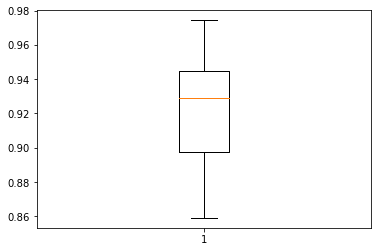

Recall: Mean = 92.16%, Standard Deviation = 3.2%
95% Confidence Interval: 85.75% to 98.56%.


In [173]:
results = cross_val_score(xgb_final,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

### The SMOTE model incurs a loss of 2% test recall with these metrics, but gains 10% specificity and 10% accuracy.
# Undersampled Model #6: Logistic Regression

These metrics are performed on the Validation set.

Accuracy on training set :  0.8620714285714286
Accuracy on val/test set :  0.8513333333333334

Recall on training set :  0.8725868725868726
Recall on val/test set :  0.8468468468468469
Precision on training set :  0.2701195219123506
Precision on val/test set :  0.25111308993766696
F1 on training set :  0.4125342257377548
F1 on val/test set :  0.3873626373626374

Specificity on training set :  0.8614535279437344
Specificity on val/test set :  0.8515969648844186
NPV on training set :  0.9913838120104439
NPV on val/test set :  0.9895427516916137
Inverted F1 on training set :  0.9218629870918141
Inverted F1 on val/test set :  0.9154021244309559

Harmonic Mean of F1 and Inverted F1 on train set :  0.5699952457331576
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.5443693160363774


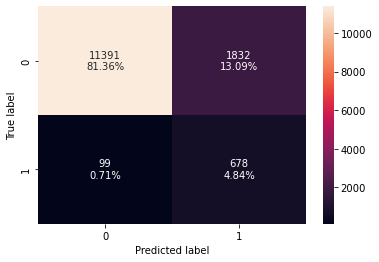

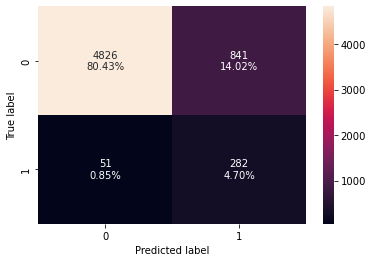

In [154]:
Log_rus =make_imb_pipeline(rus,LogisticRegression(random_state=1,max_iter=100,
    penalty='l2',solver='sag')) 
    #only increase max_iter if warning is thrown)
    #Check shift-tab for optimal Penalty and Solver
Log_rus.fit(X_train, y_train)

confusion_matrix_sklearn(Log_rus,X_train,y_train)

confusion_matrix_sklearn(Log_rus,X_val,y_val)

Log_rus_pretune = get_metrics_score(Log_rus, xtest=X_val, ytest=y_val)

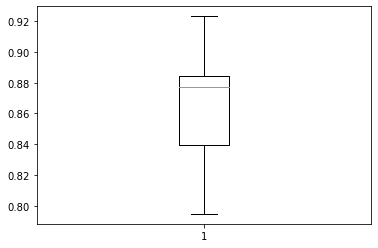

Recall: Mean = 86.37%, Standard Deviation = 3.83%
95% Confidence Interval: 78.71% to 94.02%.


In [155]:
results = cross_val_score(Log_rus,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

In [156]:
Log_rus_posttune_test = get_metrics_score(Log_rus)

These metrics are performed on the Test set.

Accuracy on training set :  0.8620714285714286
Accuracy on val/test set :  0.8584

Recall on training set :  0.8725868725868726
Recall on val/test set :  0.8156028368794326
Precision on training set :  0.2701195219123506
Precision on val/test set :  0.2595936794582393
F1 on training set :  0.4125342257377548
F1 on val/test set :  0.39383561643835624

Specificity on training set :  0.8614535279437344
Specificity on val/test set :  0.860958033064858
NPV on training set :  0.9913838120104439
NPV on val/test set :  0.9873602333495382
Inverted F1 on training set :  0.9218629870918141
Inverted F1 on val/test set :  0.9198369565217391

Harmonic Mean of F1 and Inverted F1 on train set :  0.5699952457331576
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.5515294484351313


# All undersampled performance metrics:

In [174]:
list_of_test_results=[
    dtree_rus_posttune_test,
    rf_rus_classifier_posttune_test,
    ab_rus_classifier_posttune_test,
    gb_rus_classifier_posttune_test,
    xgb_rus_classifier_posttune_test,
    xgb_final_metrics,
    Log_rus_posttune_test
]

list_=[]
for entry in list_of_test_results:
    list_.append([entry[2],entry[3]])
    
Metrics_rus=pd.DataFrame(list_,index=['dtree rus','rf rus','ab rus', 'gb rus',
                                      'xgb rus','xgb SMOTE 2','log rus'],
                     columns=['train_recall','test_recall']).sort_values('test_recall',ascending=False)

# Finally, a list of all of our train/test recalls for every model we made and tuned (sorted by test recall):

In [175]:
Metrics_full_2=pd.concat([Metrics_full,Metrics_rus])
Metrics_full_2.sort_values('test_recall',ascending=False,inplace=True)
Metrics_full_2

,train_recall,test_recall
xgb rus,0.951094,0.904255
dtree,0.909910,0.893617
xgb SMOTE 2,0.944659,0.893617
ab rus,0.996139,0.872340
gb rus,1.000000,0.868794
rf rus,0.926641,0.861702
xgb SMOTE,0.938224,0.858156
gb SMOTE,0.936937,0.858156
ab+rf SMOTE,0.998713,0.854610
rf SMOTE,0.911197,0.840426


# Our two best models are xgb_rus and xgb_SMOTE_2 (SMOTE using the better hyperparameters from the rus tuning).
### Again, the decision tree has a 55% accuracy, so it would not make for a good model.

### Below are the kFold cross validation recall scores for these models.

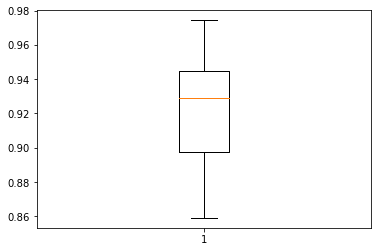

XGB SMOTE Recall: Mean = 92.16%, Standard Deviation = 3.2%
95% Confidence Interval: 85.75% to 98.56%.


In [176]:
results = cross_val_score(xgb_final,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"XGB SMOTE Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

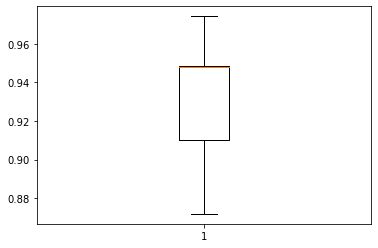

XGB rus Recall: Mean = 93.32%, Standard Deviation = 2.96%
95% Confidence Interval: 87.4% to 99.23%.


In [177]:
results = cross_val_score(xgb_rus_classifier_tuned,X_train,y_train,cv=kFold,scoring=scoring,n_jobs=-1)

plt.boxplot(results)
plt.show()

print(f"XGB rus Recall: Mean = {round(results.mean()*100,2)}%, Standard Deviation = {round(results.std()*100,2)}%")

print(f"95% Confidence Interval: {round(100*(results.mean() - 2*(results.std())),2)}% to {round(100*(results.mean() + 2*(results.std())),2)}%.")

# The XGB rus model has better overall performance, by standard deviation and mean.

## However, take a look at the metrics for these models, especially the accuracy:

In [178]:
print('XGB rus: \n')
xgb_rus_classifier_posttune_test=get_metrics_score(xgb_rus_classifier_tuned)

XGB rus: 

These metrics are performed on the Test set.

Accuracy on training set :  0.7528571428571429
Accuracy on val/test set :  0.755

Recall on training set :  0.9510939510939511
Recall on val/test set :  0.9042553191489362
Precision on training set :  0.17760153809180484
Precision on val/test set :  0.17549896765313144
F1 on training set :  0.29931146213041715
F1 on val/test set :  0.2939481268011527

Specificity on training set :  0.7412085003403162
Specificity on val/test set :  0.7460788469690547
NPV on training set :  0.996137818884033
NPV on val/test set :  0.9923879334649
Inverted F1 on training set :  0.8499696470384182
Inverted F1 on val/test set :  0.8517846339987901

Harmonic Mean of F1 and Inverted F1 on train set :  0.4427213773756897
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.43706613997340155


In [179]:
print('XGB SMOTE: \n')
xgb_final_metrics=get_metrics_score(xgb_final)

XGB SMOTE: 

These metrics are performed on the Test set.

Accuracy on training set :  0.8490714285714286
Accuracy on val/test set :  0.8452

Recall on training set :  0.9446589446589446
Recall on val/test set :  0.8936170212765957
Precision on training set :  0.26176890156918686
Precision on val/test set :  0.25301204819277107
F1 on training set :  0.40994135716280367
F1 on val/test set :  0.39436619718309857

Specificity on training set :  0.8434545867049837
Specificity on val/test set :  0.8423060618906316
NPV on training set :  0.9961593426223652
NPV on val/test set :  0.9925074925074925
Inverted F1 on training set :  0.9134690200253901
Inverted F1 on val/test set :  0.9112588855767026

Harmonic Mean of F1 and Inverted F1 on train set :  0.5659147551661278
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.5504944813017301


## Sacrificing 10% of your accuracy for a 1-2% improvement in recall is something that I personally wouldn't recommend, but ultimately, it all depends on the time and maintenance cost of a False Positive.

## We will build pipelines for both of the models and leave the decision of which to use up to the team at ReneWind.

## Pipelines to build the final model


In [188]:
Undersample_Model=make_imb_pipeline(KNNImputer(n_neighbors=5),
                  RandomUnderSampler(random_state=1, sampling_strategy = 1),
                  XGBClassifier(random_state=1,
                                subsample= 0.7,
                                scale_pos_weight= 3,
                                n_estimators= 90,
                                learning_rate= 0.0001,
                                gamma= 10,
                                colsample_bytree= 0.5,
                                colsample_bynode= 0.8,
                                colsample_bylevel= 0.3)
)
Undersample_Model.fit(X_train,y_train)

Oversample_Model=make_imb_pipeline(KNNImputer(n_neighbors=5),
                  SMOTE(sampling_strategy=1, k_neighbors=3, random_state=1),
                  XGBClassifier(random_state=1,
                                subsample= 0.7,
                                scale_pos_weight= 3,
                                n_estimators= 90,
                                learning_rate= 0.0001,
                                gamma= 10,
                                colsample_bytree= 0.5,
                                colsample_bynode= 0.8,
                                colsample_bylevel= 0.3)
)
Oversample_Model.fit(X_train,y_train)

X_Test_Transformations=make_imb_pipeline(KNNImputer(n_neighbors=5))
X_Test_Transformations.fit(X_train)

Pipeline(steps=[('knnimputer', KNNImputer())])

### 2% Better failure prediction = Undersample_Model
### 10% Better model accuracy = Oversample_Model

# Using Pickle to distribute the models and the data transformation pipeline.

In [190]:
import pickle

pickle.dump(Undersample_Model, open('Undersample_Model.pkl','wb'))
pickle.dump(Oversample_Model, open('Oversample_Model.pkl','wb'))
pickle.dump(X_Test_Transformations, open('X_Test_Transformations.pkl','wb'))

Undersample = pickle.load(open('Undersample_Model.pkl','rb'))
Oversample = pickle.load(open('Oversample_Model.pkl','rb'))

In [191]:
get_metrics_score(Undersample)

These metrics are performed on the Test set.

Accuracy on training set :  0.7528571428571429
Accuracy on val/test set :  0.755

Recall on training set :  0.9510939510939511
Recall on val/test set :  0.9042553191489362
Precision on training set :  0.17760153809180484
Precision on val/test set :  0.17549896765313144
F1 on training set :  0.29931146213041715
F1 on val/test set :  0.2939481268011527

Specificity on training set :  0.7412085003403162
Specificity on val/test set :  0.7460788469690547
NPV on training set :  0.996137818884033
NPV on val/test set :  0.9923879334649
Inverted F1 on training set :  0.8499696470384182
Inverted F1 on val/test set :  0.8517846339987901

Harmonic Mean of F1 and Inverted F1 on train set :  0.4427213773756897
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.43706613997340155


[0.7528571428571429,
 0.755,
 0.9510939510939511,
 0.9042553191489362,
 0.17760153809180484,
 0.17549896765313144,
 0.29931146213041715,
 0.2939481268011527,
 0.7412085003403162,
 0.7460788469690547,
 0.996137818884033,
 0.9923879334649,
 0.8499696470384182,
 0.8517846339987901,
 0.4427213773756897,
 0.43706613997340155]

In [192]:
get_metrics_score(Oversample)

These metrics are performed on the Test set.

Accuracy on training set :  0.8490714285714286
Accuracy on val/test set :  0.8452

Recall on training set :  0.9446589446589446
Recall on val/test set :  0.8936170212765957
Precision on training set :  0.26176890156918686
Precision on val/test set :  0.25301204819277107
F1 on training set :  0.40994135716280367
F1 on val/test set :  0.39436619718309857

Specificity on training set :  0.8434545867049837
Specificity on val/test set :  0.8423060618906316
NPV on training set :  0.9961593426223652
NPV on val/test set :  0.9925074925074925
Inverted F1 on training set :  0.9134690200253901
Inverted F1 on val/test set :  0.9112588855767026

Harmonic Mean of F1 and Inverted F1 on train set :  0.5659147551661278
Harmonic Mean of F1 and Inverted F1 on val/test set :  0.5504944813017301


[0.8490714285714286,
 0.8452,
 0.9446589446589446,
 0.8936170212765957,
 0.26176890156918686,
 0.25301204819277107,
 0.40994135716280367,
 0.39436619718309857,
 0.8434545867049837,
 0.8423060618906316,
 0.9961593426223652,
 0.9925074925074925,
 0.9134690200253901,
 0.9112588855767026,
 0.5659147551661278,
 0.5504944813017301]

# How to transform new sensor data for maximum prediction recall (using our pickle X_Test_Transformations):

In [193]:
New_Data=test.drop('Target',axis=1)
New_Data


TestTransformations = pickle.load(open('X_Test_Transformations.pkl','rb'))
New_Data=TestTransformations.transform(New_Data)
New_Data

array([[ -0.61348881,  -3.81963982,   2.2023017 , ..., -10.5113424 ,
          0.45466428,  -1.44836301],
       [  0.38960774,  -0.51234071,   0.52705265, ...,   5.12835007,
          1.72074376,  -1.4882354 ],
       [ -0.87486145,  -0.64063227,   4.08420234, ...,  -1.75215383,
          1.80830179,   1.67574759],
       ...,
       [ -1.11413649,  -0.40357553,  -1.76487457, ...,  -1.24563274,
         -1.26087591,   7.47468203],
       [ -1.7032406 ,   0.6146499 ,   6.22050312, ...,  -4.03616425,
          3.43605111,   0.57924928],
       [ -0.60370065,   0.95954957,  -0.72099507, ...,  -0.91808304,
         -2.29115431,  -5.36289098]])

# Quick look at the Gini Importances of each model:

### Note from bivariate analysis: The strongest correlations between the dependent and target variables are V18 (-0.293), V39 (-0.227), V15 (0.249), and V21 (0.256).

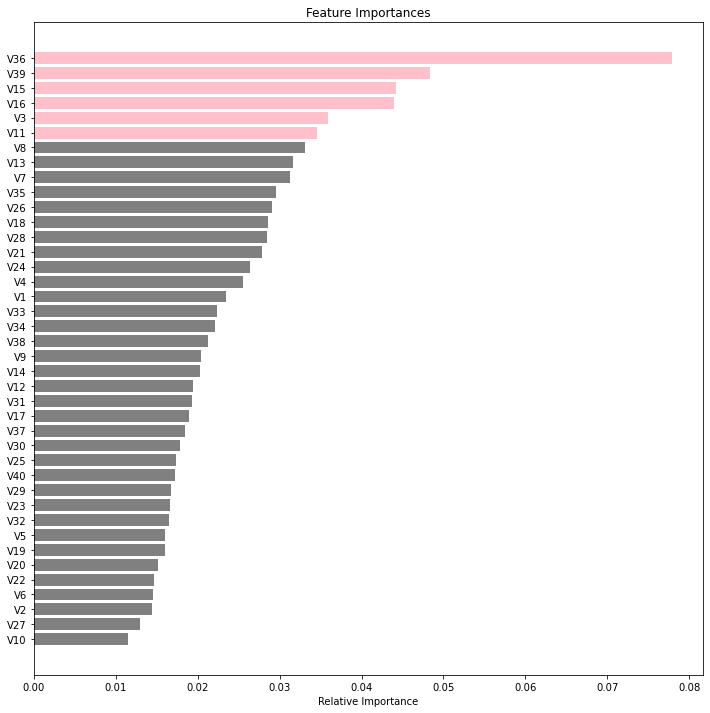

In [186]:
colorlist_=[]
for entry in range(40):
    if entry >33:
        colorlist_.append('pink')
    else:
        colorlist_.append('gray')

feature_names = X_train.columns
importances = Undersample.steps[2][1].feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color=colorlist_, align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

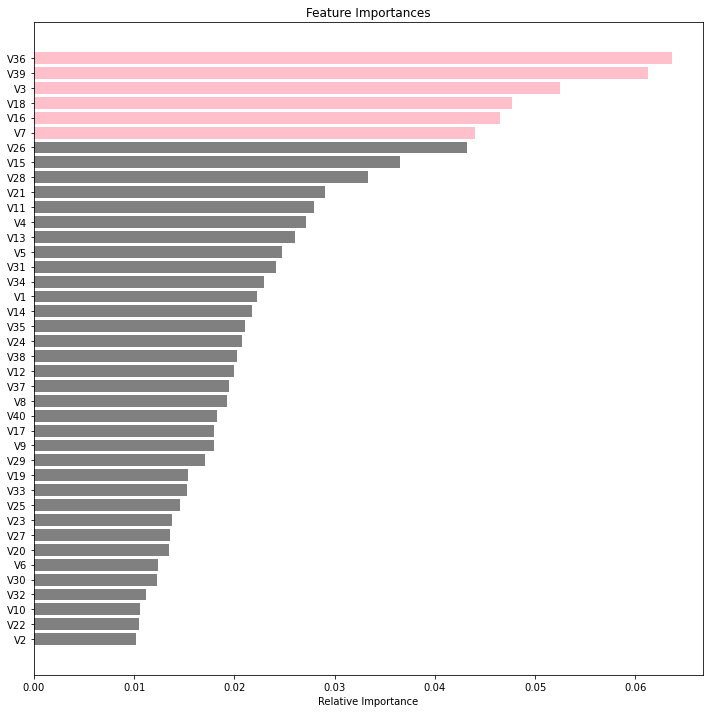

In [187]:
colorlist_=[]
for entry in range(40):
    if entry >33:
        colorlist_.append('pink')
    else:
        colorlist_.append('gray')

feature_names = X_train.columns
importances = Oversample.steps[2][1].feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color=colorlist_, align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

### As it turns out, most of the correlations between the dependent and independent variables did not have an effect on the feature importances of our two best models.

### The two most important features are consistently V36 and V39, in that order.

---
---
---
---


# <span style='font-size:larger'>Business Insights and Conclusions</span>

# We have provided two models for ReneWind to use in the prediction of failing wind turbines.
### The "Oversample" model is best for optimizing overall accuracy without a noticeable loss in failure prediction, and the "Undersample" model is best for maximizing failure prediction at the cost of misidentifying 10% more perfectly operational turbines as failing (see: Test Specificity on the Undersample model vs Oversample model).
### The most important features are V36 and V39 across both models, both being around 0.5-0.8 relative importance. There are no features with zero importance to the model, so it appears there are no sensors that are reporting useless information.
### I am including an X_Test_Transformation pipeline. This will be used to transform new sensor data for prediction purposes (tutorial above).

### If either of our models are chosen to be used by ReneWind, they will predict between 86-99% of all turbine failures (with a 95% confidence interval), giving an average of around 93% of all failures correctly predicted over time.

## If you would like to contact us about the implementation of either of these models, please use the business address available on the website.